# CV - Project 1 Super-Resolution

## Imports

In [1]:
import numpy as np 
import pandas as pd 
import os
import re
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Conv2D, MaxPooling2D, Dropout, Conv2DTranspose, UpSampling2D, add, Flatten, Lambda, Reshape, BatchNormalization, concatenate, AveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras import regularizers
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.python.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, TensorBoard
import matplotlib.pyplot as plt
import scipy
from PIL import Image
import random
import cv2
from tensorflow.keras.metrics import MeanAbsoluteError, MeanSquaredError, RootMeanSquaredError, Mean, binary_crossentropy, binary_accuracy
from sklearn.model_selection import train_test_split
from tqdm import tqdm

#### Constants

In [2]:
INPUT_SHAPE = (400, 600, 3)
IMAGE_SHAPE = (400, 600)
BATCH_SIZE = 8
EPOCHS = 2
seed = 42

### GPU Mounting

In [3]:
try:
    import google.colab
    in_colab = True
except ImportError:
    in_colab = False

if in_colab:
    try:
        tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
        print('Running on TPU ', tpu.cluster_spec().as_dict()['worker'])
        tf.config.experimental_connect_to_cluster(tpu)
        tf.tpu.experimental.initialize_tpu_system(tpu)
        tpu_strategy = tf.distribute.TPUStrategy(tpu)
    except ValueError:
        if 'GPU' in [gpu[-1] for gpu in tf.config.list_physical_devices('GPU')]:
            print('Running on Google Colab GPU')
        else:
            print('Not connected to a TPU or GPU runtime')

else:
    physical_devices = tf.config.list_physical_devices('GPU')
    print(physical_devices)
    try:
        if len(physical_devices):
            for gpu in physical_devices:
                tf.config.experimental.set_memory_growth(gpu, enable = True)
                print(f"Using local GPU: {gpu}")
            sess = tf.compat.v1.Session(config = tf.compat.v1.ConfigProto(log_device_placement = True))
        else:
            print("No local GPU found")
    except:
        print("Error Mounting a GPU")

[]
No local GPU found


## Data

### Functions

In [4]:
def filter_df(df, viable_nums=["2", "4", "6"]):
    condition = df['low_res'].str.endswith(tuple(num + ".jpg" for num in viable_nums))
    filtered_df = df[condition]
    return filtered_df

In [5]:
def read_images(df):
    new_df = pd.DataFrame(columns=["low_res", "high_res"])

    for index, row in df.iterrows():
            low_res_path = row["low_res"]
            low_res_img = Image.open(low_res_path)
            low_res_array = np.array(low_res_img)

            high_res_path = row["high_res"]
            high_res_img = Image.open(high_res_path)
            high_res_array = np.array(high_res_img)
            new_row = {
                "low_res" : low_res_array,
                "high_res" : high_res_array,
            }
            new_df = pd.concat([new_df, pd.DataFrame([new_row])], ignore_index=True)
        
    return new_df

In [6]:
def show_random_image(generator, num_rows=1, seed=42):
    random.seed(seed)
    plt.figure(figsize=(12, 3 * num_rows))

    for _ in range(num_rows):
        low_res_array, high_res_array = next(generator)

        plt.subplot(num_rows, 2, 2 * _ + 1)
        plt.imshow(low_res_array[0])
        plt.title(f"Low Resolution - Batch {_}")
        plt.axis("off")

        plt.subplot(num_rows, 2, 2 * _ + 2)
        plt.imshow(high_res_array[0])
        plt.title(f"High Resolution - Batch {_}")
        plt.axis("off")
        
    plt.tight_layout()
    plt.show()

In [7]:
def reshape_images(df, target_shape = IMAGE_SHAPE):
    new_df = pd.DataFrame(columns=["low_res", "high_res"])

    for index, row in df.iterrows():
        low_res_img = cv2.resize(row["low_res"], target_shape[::-1]) /255.0
        high_res_img = cv2.resize(row["high_res"], target_shape[::-1]) /255.0
        new_row = {
            "low_res": low_res_img,
            "high_res": high_res_img
        }
        new_df = pd.concat([new_df, pd.DataFrame([new_row])], ignore_index=True)

    return new_df

### Data Reading

In [8]:
base_directory = 'data'
hires_folder = os.path.join(base_directory, 'high res')
lowres_folder = os.path.join(base_directory, 'low res')

data = pd.read_csv("data/image_data.csv")
data['low_res'] = data['low_res'].apply(lambda x: os.path.join(lowres_folder, x))
data['high_res'] = data['high_res'].apply(lambda x: os.path.join(hires_folder, x))
data.head()

data = filter_df(data, viable_nums=["6"])

train_data, val_test_data = train_test_split(data, test_size=0.2, random_state=42)
val_data, test_data = train_test_split(val_test_data, test_size=0.5, random_state=42)

image_datagen = ImageDataGenerator(rescale=1./255)
mask_datagen = ImageDataGenerator(rescale=1./255)

train_hiresimage_generator = image_datagen.flow_from_dataframe(
    train_data,
    x_col='high_res',
    target_size=IMAGE_SHAPE,
    class_mode=None,
    batch_size=BATCH_SIZE,
    seed=42
)

train_lowresimage_generator = image_datagen.flow_from_dataframe(
    train_data,
    x_col='low_res',
    target_size=IMAGE_SHAPE,
    class_mode=None,
    batch_size=BATCH_SIZE,
    seed=42
)

val_hiresimage_generator = image_datagen.flow_from_dataframe(
    val_data,
    x_col='high_res',
    target_size=IMAGE_SHAPE,
    class_mode=None,
    batch_size=BATCH_SIZE,
    seed=42
)

val_lowresimage_generator = image_datagen.flow_from_dataframe(
    val_data,
    x_col='low_res',
    target_size=IMAGE_SHAPE,
    class_mode=None,
    batch_size=BATCH_SIZE,
    seed=42
)

test_hiresimage_generator = image_datagen.flow_from_dataframe(
    test_data,
    x_col='high_res',
    target_size=IMAGE_SHAPE,
    class_mode=None,
    batch_size=BATCH_SIZE,
    seed=42
)

test_lowresimage_generator = image_datagen.flow_from_dataframe(
    test_data,
    x_col='low_res',
    target_size=IMAGE_SHAPE,
    class_mode=None,
    batch_size=BATCH_SIZE,
    seed=42
)

train_generator = zip(train_lowresimage_generator, train_hiresimage_generator)
val_generator = zip(val_lowresimage_generator, val_hiresimage_generator)
test_generator = zip(test_lowresimage_generator, test_hiresimage_generator)

def imageGenerator(generator):
    for (low_res, hi_res) in generator:
        yield (low_res, hi_res)

Found 1003 validated image filenames.
Found 1003 validated image filenames.
Found 125 validated image filenames.
Found 125 validated image filenames.
Found 126 validated image filenames.
Found 126 validated image filenames.


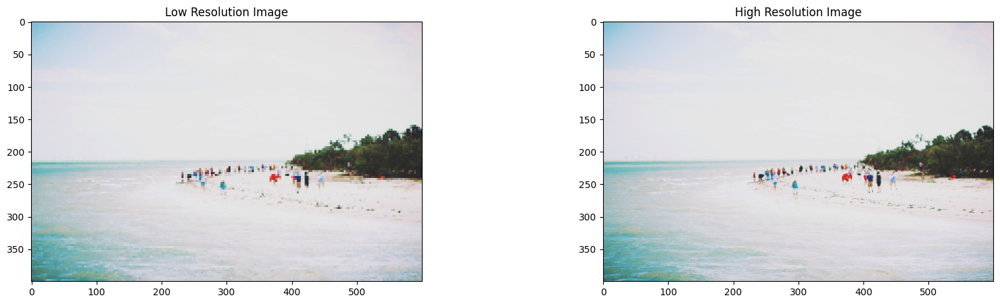

In [9]:
n = 0
for i,m in train_generator:
    img,out = i,m

    if n < 1:
        fig, axs = plt.subplots(1 , 2, figsize=(20,5))
        axs[0].imshow(img[0])
        axs[0].set_title('Low Resolution Image')
        axs[1].imshow(out[0])
        axs[1].set_title('High Resolution Image')
        plt.show()
        n+=1
    else:
        break

In [10]:
train_samples = train_hiresimage_generator.samples
val_samples = val_hiresimage_generator.samples

train_img_gen = imageGenerator(train_generator)
val_img_gen = imageGenerator(val_generator)
test_img_gen = imageGenerator(test_generator)

### Visualizations

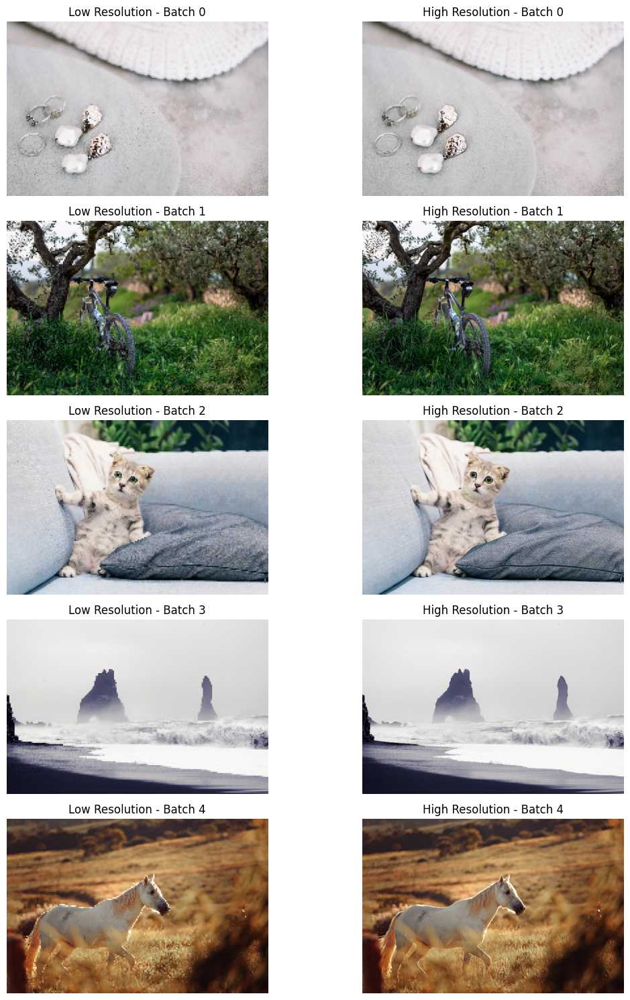

In [11]:
show_random_image(train_img_gen, num_rows=5)

In [1]:
#show_random_image(val_img_gen, num_rows=5)

In [2]:
#show_random_image(test_img_gen, num_rows=5)

## Models

### Standard Convolutional

In [14]:
def build_conv_model(input_shape=INPUT_SHAPE):
    # Input layer
    input_img = Input(shape=input_shape)

    # Convolutional layers
    conv1 = Conv2D(16, (3, 3), padding='same', activation='elu')(input_img)
    conv2 = Conv2D(32, (3, 3), padding='same', activation='elu')(conv1)
    conv3 = Conv2D(64, (3, 3), padding='same', activation='elu')(conv2)
    conv4 = Conv2D(32, (3, 3), padding='same', activation='elu')(conv3)
    conv5 = Conv2D(16, (3, 3), padding='same', activation='elu')(conv4)

    # Output layer
    output_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid')(conv5)

    conv_model = Model(input_img, output_img)
    metrics_list = ['accuracy', MeanAbsoluteError(name='mae'), RootMeanSquaredError(name='rmse')]
    conv_model.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics_list)

    return conv_model

In [15]:
conv_model = build_conv_model()
conv_model.summary()



Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 400, 600, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 400, 600, 16)      448       
                                                                 
 conv2d_1 (Conv2D)           (None, 400, 600, 32)      4640      
                                                                 
 conv2d_2 (Conv2D)           (None, 400, 600, 64)      18496     
                                                                 
 conv2d_3 (Conv2D)           (None, 400, 600, 32)      18464     
                                                                 
 conv2d_4 (Conv2D)           (None, 400, 600, 16)      4624      
                                                                 
 conv2d_5 (Conv2D)           (None, 400, 600, 3)       435 

### Autoencoders

In [16]:
def build_autoencoder_model(input_shape=INPUT_SHAPE):
    # Input layer
    input_img = Input(shape=input_shape)

    # Encoder
    conv1 = Conv2D(16, (3, 3), padding='same', activation='elu')(input_img)
    conv2 = Conv2D(32, (3, 3), padding='same', activation='elu')(conv1)
    maxpool1 = MaxPooling2D(padding='same')(conv2)
    dropout1 = Dropout(0.2)(maxpool1)
    maxpool2 = MaxPooling2D(padding='same')(dropout1)
    conv3 = Conv2D(64, (3, 3), padding='same', activation='elu')(maxpool2)

    # Decoder
    upsample1 = UpSampling2D()(conv3)
    conv4 = Conv2D(64, (3, 3), padding='same', activation='elu')(upsample1)
    conv5 = Conv2D(64, (3, 3), padding='same', activation='elu')(conv4)

    upsample2 = UpSampling2D()(conv5)
    conv6 = Conv2D(32, (3, 3), padding='same', activation='elu')(upsample2)
    conv7 = Conv2D(16, (3, 3), padding='same', activation='elu')(conv6)

    # Output layer
    decoded = Conv2D(3, (3, 3), padding='same', activation='sigmoid')(conv7)

    # Create and compile Autoencoder model
    autoencoder = Model(input_img, decoded)
    metrics_list = ['accuracy', MeanAbsoluteError(name='mae'), RootMeanSquaredError(name='rmse')]
    autoencoder.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics_list)

    return autoencoder

In [17]:
autoencoder = build_autoencoder_model()
autoencoder.summary()


Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 400, 600, 3)]     0         
                                                                 
 conv2d_6 (Conv2D)           (None, 400, 600, 16)      448       
                                                                 
 conv2d_7 (Conv2D)           (None, 400, 600, 32)      4640      
                                                                 
 max_pooling2d (MaxPooling2  (None, 200, 300, 32)      0         
 D)                                                              
                                                                 
 dropout (Dropout)           (None, 200, 300, 32)      0         
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 100, 150, 32)      0         
 g2D)                                                     

### U-Net like architecture

In [18]:
def build_u_net(input_shape=INPUT_SHAPE):
    # Input layer
    input_img = Input(shape=input_shape)

    # Encoder
    conv1 = Conv2D(16, (3, 3), padding='same', activation='relu')(input_img)
    conv2 = Conv2D(16, (3, 3), padding='same', activation='relu')(conv1)
    maxpool1 = MaxPooling2D()(conv2)

    conv3 = Conv2D(32, (3, 3), padding='same', activation='relu')(maxpool1)
    conv4 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv3)
    maxpool2 = MaxPooling2D()(conv4)

    conv5 = Conv2D(64, (3, 3), padding='same', activation='relu')(maxpool2)
    conv6 = Conv2D(64, (3, 3), padding='same', activation='relu')(conv5)

    # Bottleneck
    bottleneck = Conv2D(64, (3, 3), padding='same', activation='relu')(conv6)
    maxpool3 = MaxPooling2D(pool_size=(2, 2))(bottleneck)

    # Decoder
    upsample1 = UpSampling2D()(maxpool3)
    concat1 = concatenate([upsample1, conv5], axis=-1)
    conv7 = Conv2D(64, (3, 3), padding='same', activation='relu')(concat1)
    conv8 = Conv2D(64, (3, 3), padding='same', activation='relu')(conv7)

    upsample2 = UpSampling2D()(conv8)
    concat2 = concatenate([upsample2, conv3], axis=-1)
    conv9 = Conv2D(32, (3, 3), padding='same', activation='relu')(concat2)
    conv10 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv9)

    upsample3 = UpSampling2D()(conv10)
    concat3 = concatenate([upsample3, conv1], axis=-1)
    conv11 = Conv2D(16, (3, 3), padding='same', activation='relu')(concat3)
    conv12 = Conv2D(16, (3, 3), padding='same', activation='relu')(conv11)

    # Output layer
    output_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid')(conv12)

    unet = Model(input_img, output_img)    
    metrics_list = ['accuracy', MeanAbsoluteError(name='mae'), RootMeanSquaredError(name='rmse')]
    unet.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics_list)
    
    return unet

In [19]:
Unet = build_u_net()
Unet.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 400, 600, 3)]        0         []                            
                                                                                                  
 conv2d_14 (Conv2D)          (None, 400, 600, 16)         448       ['input_3[0][0]']             
                                                                                                  
 conv2d_15 (Conv2D)          (None, 400, 600, 16)         2320      ['conv2d_14[0][0]']           
                                                                                                  
 max_pooling2d_2 (MaxPoolin  (None, 200, 300, 16)         0         ['conv2d_15[0][0]']           
 g2D)                                                                                       

### Inception like model 1

In [20]:
def inception_block(x, filters):
    conv1x1 = Conv2D(filters[0], (1, 1), padding='same', activation='relu')(x)
    conv3x3 = Conv2D(filters[1], (3, 3), padding='same', activation='relu')(x)
    conv5x5 = Conv2D(filters[2], (5, 5), padding='same', activation='relu')(x)
    pool = tf.keras.layers.MaxPooling2D((3, 3), strides=(1, 1), padding='same')(x)
    inception_block = concatenate([conv1x1, conv3x3, conv5x5, pool], axis=-1)

    return inception_block

In [21]:
def build_inception_model(input_shape=INPUT_SHAPE):
    input_img = Input(shape=input_shape)
    inception1 = inception_block(input_img, [8, 8, 8])
    incpetion2 = inception_block(inception1, [16, 16, 16])
    partial_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid', name="output_1")(incpetion2)
    inception3 = inception_block(incpetion2, [32, 32, 32])
    output_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid', name="output_2")(inception3)
    
    inception = Model(inputs=input_img, outputs=[output_img, partial_img])    
    metrics_list = ['accuracy', MeanAbsoluteError(name='mae'), RootMeanSquaredError(name='rmse')]
    inception.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics_list)
    
    return inception

In [22]:
inception = build_inception_model()
inception.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 400, 600, 3)]        0         []                            
                                                                                                  
 conv2d_28 (Conv2D)          (None, 400, 600, 8)          32        ['input_4[0][0]']             
                                                                                                  
 conv2d_29 (Conv2D)          (None, 400, 600, 8)          224       ['input_4[0][0]']             
                                                                                                  
 conv2d_30 (Conv2D)          (None, 400, 600, 8)          608       ['input_4[0][0]']             
                                                                                            

### Inception like model 2

In [23]:
def alt_inception_block(x, filters):
    conv1x1 = Conv2D(filters, (1, 1), padding='same', activation='relu')(x)
    conv1x1_2 = Conv2D(filters, (1, 1), padding='same', activation='relu')(x)
    conv1x1_3 = Conv2D(filters, (1, 1), padding='same', activation='relu')(x)
    conv3x3 = Conv2D(filters, (3, 3), padding='same', activation='relu')(conv1x1_2)
    conv5x5 = Conv2D(filters, (5, 5), padding='same', activation='relu')(conv1x1_3)
    pool = tf.keras.layers.MaxPooling2D((3, 3), strides=(1, 1), padding='same')(x)
    conv1x1_4 = Conv2D(filters, (1, 1), padding='same', activation='relu')(pool)
    inception_block = concatenate([conv1x1, conv3x3, conv5x5, conv1x1_4], axis=-1)

    return inception_block

In [24]:
def build_alt_inception_model(input_shape=INPUT_SHAPE):
    input_img = Input(shape=input_shape)
    
    conv1 = Conv2D(4, (7, 7), padding='same', activation='relu')(input_img)
    maxpool1 = MaxPooling2D((3, 3), strides=(1, 1), padding='same')(conv1)
    batch1 = BatchNormalization()(maxpool1)
    
    conv2 = Conv2D(8, (1, 1), padding='same', activation='relu')(batch1)
    conv3 = Conv2D(8, (1, 1), padding='same', activation='relu')(conv2)
    batch2 = BatchNormalization()(conv3)
    maxpool2 = MaxPooling2D((3, 3), strides=(1, 1), padding='same')(batch2)

    inception1 = alt_inception_block(maxpool2, 8)
    output_img_1 = Conv2D(3, (3, 3), padding='same', activation='sigmoid', name="output_1")(inception1)
    batch3 = BatchNormalization()(inception1)
    incpetion2 = alt_inception_block(batch3, 16)
    output_img_2 = Conv2D(3, (3, 3), padding='same', activation='sigmoid', name="output_2")(incpetion2)
    batch4 = BatchNormalization()(incpetion2)
    inception3 = alt_inception_block(batch4, 32)
    output_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid', name="output_3")(inception3)
    
    inception = Model(inputs=input_img, outputs=[output_img, output_img_1, output_img_2])    
    metrics_list = ['accuracy', MeanAbsoluteError(name='mae'), RootMeanSquaredError(name='rmse')]
    inception.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics_list)
    
    return inception

In [25]:
inception_alt = build_alt_inception_model()
inception_alt.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_5 (InputLayer)        [(None, 400, 600, 3)]        0         []                            
                                                                                                  
 conv2d_37 (Conv2D)          (None, 400, 600, 4)          592       ['input_5[0][0]']             
                                                                                                  
 max_pooling2d_8 (MaxPoolin  (None, 400, 600, 4)          0         ['conv2d_37[0][0]']           
 g2D)                                                                                             
                                                                                                  
 batch_normalization (Batch  (None, 400, 600, 4)          16        ['max_pooling2d_8[0][0]'

### Skip-Connections model

In [26]:
def build_skip_connections_model(input_shape=(800, 1200, 3)):
    # Input layer
    input_img = Input(shape=input_shape)

    # Convolutional layers
    conv1 = Conv2D(16, (3, 3), padding='same', activation='relu')(input_img)
    conv2 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv1)
    conv3 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv2)
    conv4 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv3)
    concat1 = add([conv3, conv4])
    conv5 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv1)
    concat2 = add([concat1, conv5])
    conv6 = Conv2D(32, (3, 3), padding='same', activation='relu')(concat2)
    concat3 = add([concat2, conv6])
    concat4 = add([concat3, conv2])
    conv7 = Conv2D(32, (3, 3), padding='same', activation='relu')(concat4)
    conv8 = Conv2D(64, (3, 3), padding='same', activation='relu')(conv7)
    conv9 = Conv2D(64, (3, 3), padding='same', activation='relu')(conv8)

    # Output layer
    output_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid')(conv9)

    skip_model = Model(input_img, output_img)
    metrics_list = ['accuracy', MeanAbsoluteError(name='mae'), RootMeanSquaredError(name='rmse')]
    skip_model.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics_list)

    return skip_model

In [27]:
skip_model = build_skip_connections_model()
skip_model.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_6 (InputLayer)        [(None, 800, 1200, 3)]       0         []                            
                                                                                                  
 conv2d_58 (Conv2D)          (None, 800, 1200, 16)        448       ['input_6[0][0]']             
                                                                                                  
 conv2d_59 (Conv2D)          (None, 800, 1200, 32)        4640      ['conv2d_58[0][0]']           
                                                                                                  
 conv2d_60 (Conv2D)          (None, 800, 1200, 32)        9248      ['conv2d_59[0][0]']           
                                                                                            

### Skip-Connections model 2

In [28]:
def build_skip_connections_model_2(input_shape=INPUT_SHAPE):
    # Input layer
    input_img = Input(shape=input_shape)

    # Convolutional layers
    conv1 = Conv2D(8, (3, 3), padding='same', activation='relu')(input_img)
    conv1 = Dropout(0.2)(conv1)
    conv2 = Conv2D(16, (3, 3), padding='same', activation='relu')(conv1)
    conv3 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv2)
    conv3 = BatchNormalization()(conv3)
    concat1 = concatenate([conv1, conv3], axis=-1)

    conv4 = Conv2D(32, (3, 3), padding='same', activation='relu')(concat1)
    conv5 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv4)
    conv5 = BatchNormalization()(conv5)
    concat2 = concatenate([conv2, conv5], axis=-1)
    concat3 = concatenate([concat1, concat2], axis=-1)
    conv6 = Conv2D(64, (3, 3), padding='same', activation='relu')(concat3)
    conv6 = Dropout(0.2)(conv6)
    hidden_conv = Conv2D(8, (7, 7), padding='same', activation='elu')(conv1)
    hidden_conv = AveragePooling2D((5, 5), strides=(1, 1), padding='same')(hidden_conv) 
    concat4 = concatenate([conv6, hidden_conv], axis=-1)
    conv7 = Conv2D(64, (3, 3), padding='same', activation='elu')(concat4)

    # Output layer
    output_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid')(conv7)

    skip_model = Model(input_img, output_img)
    metrics_list = ['accuracy', MeanAbsoluteError(name='mae'), RootMeanSquaredError(name='rmse')]
    skip_model.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics_list)

    return skip_model

In [29]:
skip_model_2 = build_skip_connections_model_2()
skip_model_2.summary()

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_7 (InputLayer)        [(None, 400, 600, 3)]        0         []                            
                                                                                                  
 conv2d_68 (Conv2D)          (None, 400, 600, 8)          224       ['input_7[0][0]']             
                                                                                                  
 dropout_1 (Dropout)         (None, 400, 600, 8)          0         ['conv2d_68[0][0]']           
                                                                                                  
 conv2d_69 (Conv2D)          (None, 400, 600, 16)         1168      ['dropout_1[0][0]']           
                                                                                            

### GANs

In [30]:
def make_generator_model(input_shape=INPUT_SHAPE):
    # Input layer
    input_img = Input(shape=input_shape)

    # Convolutional layers
    conv1 = Conv2D(8, (3, 3), padding='same', activation='elu')(input_img)
    conv2 = Conv2D(16, (3, 3), padding='same', activation='elu')(conv1)
    conv3 = Conv2D(32, (3, 3), padding='same', activation='elu')(conv2)
    conv4 = Conv2D(64, (3, 3), padding='same', activation='elu')(conv3)
    concat1 = concatenate([conv2, conv4], axis=-1)
    conv5 = Conv2D(64, (3, 3), padding='same', activation='elu')(concat1)
    output_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid')(conv5)

    # Create the model
    generator_model = Model(inputs=input_img, outputs=output_img)
    return generator_model

In [31]:
generator = make_generator_model()
generator.summary()

Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_8 (InputLayer)        [(None, 400, 600, 3)]        0         []                            
                                                                                                  
 conv2d_77 (Conv2D)          (None, 400, 600, 8)          224       ['input_8[0][0]']             
                                                                                                  
 conv2d_78 (Conv2D)          (None, 400, 600, 16)         1168      ['conv2d_77[0][0]']           
                                                                                                  
 conv2d_79 (Conv2D)          (None, 400, 600, 32)         4640      ['conv2d_78[0][0]']           
                                                                                            

In [32]:
def make_discriminator_model(input_shape=INPUT_SHAPE):
    # Input layer
    input_img = Input(shape=input_shape)

    # Convolutional layers
    conv1 = Conv2D(8, (7, 7), activation='relu')(input_img)
    conv2 = Conv2D(16, (7, 7), activation='relu')(conv1)
    conv3 = Conv2D(32, (7, 7), activation='relu')(conv2)
    conv4 = Conv2D(4, (7, 7), activation='relu')(conv3)
    maxpool1 = MaxPooling2D((7, 7))(conv4)
    flatten = Flatten()(maxpool1)
    output_img = Dense(1, activation='sigmoid')(flatten)

    # Create the model
    discriminator_model = Model(inputs=input_img, outputs=output_img)
    return discriminator_model

In [33]:
discriminator = make_discriminator_model()
discriminator.summary()

Model: "model_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_9 (InputLayer)        [(None, 400, 600, 3)]     0         
                                                                 
 conv2d_83 (Conv2D)          (None, 394, 594, 8)       1184      
                                                                 
 conv2d_84 (Conv2D)          (None, 388, 588, 16)      6288      
                                                                 
 conv2d_85 (Conv2D)          (None, 382, 582, 32)      25120     
                                                                 
 conv2d_86 (Conv2D)          (None, 376, 576, 4)       6276      
                                                                 
 max_pooling2d_13 (MaxPooli  (None, 53, 82, 4)         0         
 ng2D)                                                           
                                                           

In [34]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [35]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [36]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [37]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

## Training

### Functions and Callbacks

In [38]:
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr_plateau = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, verbose=1)
tensorboard = TensorBoard(log_dir='logs')

In [39]:
def plot_history(history):
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

In [40]:
def plot_predictions(model, generator, num_examples=5, seed=42, size=(12, 4)):
    np.random.seed(seed)

    for _ in range(num_examples):
        x_sample, y_sample = next(generator)

        # Predict
        y_pred = model.predict(x_sample, verbose=False)

        # Plot
        plt.figure(figsize=size)
        plt.subplot(1, 3, 1)
        plt.imshow(x_sample[0], cmap='gray')
        plt.title('Original')

        plt.subplot(1, 3, 2)
        plt.imshow(y_sample[0], cmap='gray')
        plt.title('Expected')

        plt.subplot(1, 3, 3)
        plt.imshow(y_pred[0], cmap='gray')
        plt.title('Reconstructed by Model')

        plt.show()

In [41]:
def plot_predictions_many_outputs(model, generator, num_examples=5, seed=42, size=(16, 4)):
    np.random.seed(seed)

    for _ in range(num_examples):
        x_sample, y_sample = next(generator)

        # Predict
        y_preds = model.predict(x_sample, verbose=False)

        # Plot
        plt.figure(figsize=size)

        # Plot original input
        plt.subplot(1, len(y_preds) + 2, 1)
        plt.imshow(x_sample[0], cmap='gray')
        plt.title('Original')

        # Plot ground truth
        plt.subplot(1, len(y_preds) + 2, 2)
        plt.imshow(y_sample[0], cmap='gray')
        plt.title('Expected')

        # Plot model predictions
        for j, y_pred in enumerate(y_preds):
            plt.subplot(1, len(y_preds) + 2, j + 3)
            plt.imshow(y_pred[0], cmap='gray')
            plt.title(f'Reconstructed by Model (Output {j + 1})')

        plt.show()

### Standard Convolutional

In [42]:
history = conv_model.fit(
    train_img_gen,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    steps_per_epoch=train_samples//BATCH_SIZE,
    validation_data = val_img_gen,
    validation_steps=val_samples//BATCH_SIZE,
    callbacks=[early_stopping, reduce_lr_plateau]
)

Epoch 1/2


  3/125 [..............................] - ETA: 6:25 - loss: 0.0945 - accuracy: 0.2684 - mae: 0.2681 - rmse: 0.3073

#### History Plot

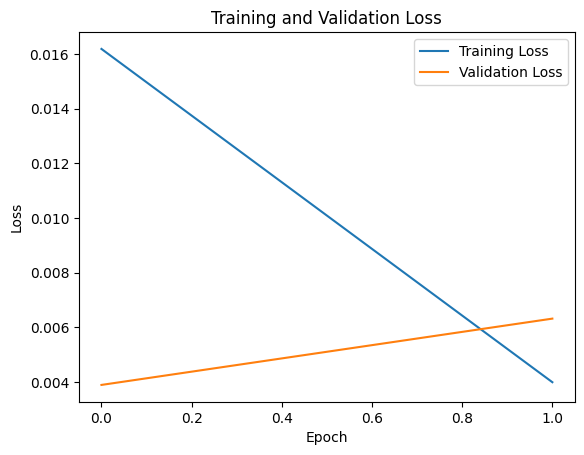

In [ ]:
plot_history(history)

#### Predictions for Training set

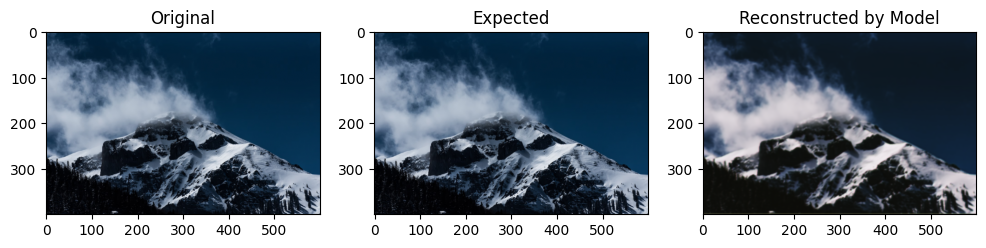

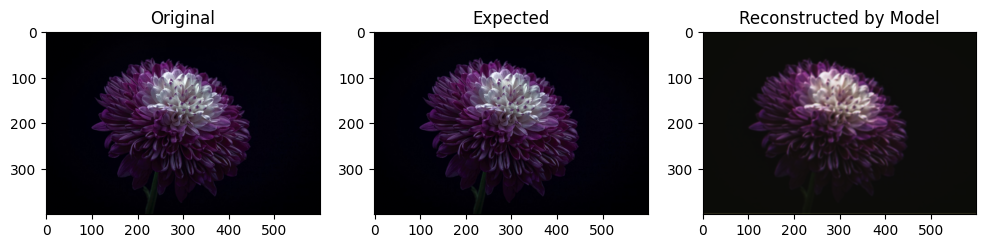

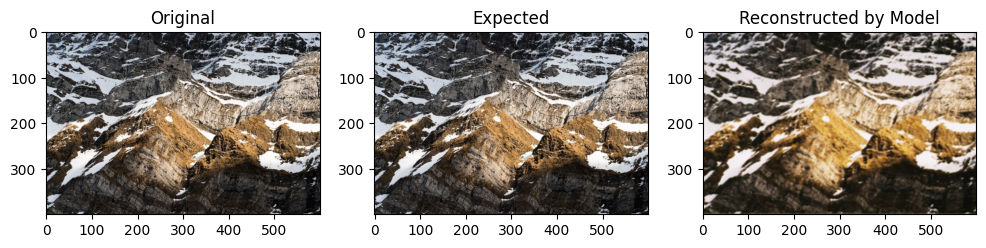

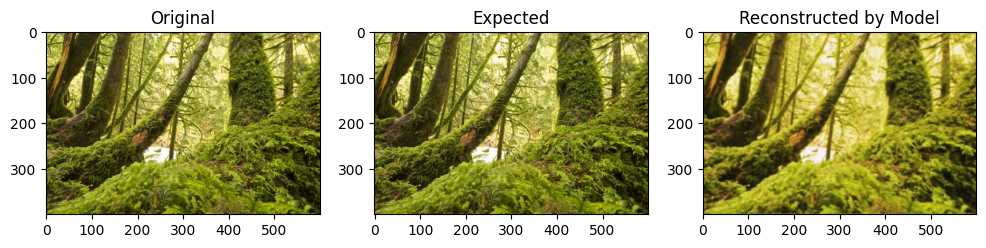

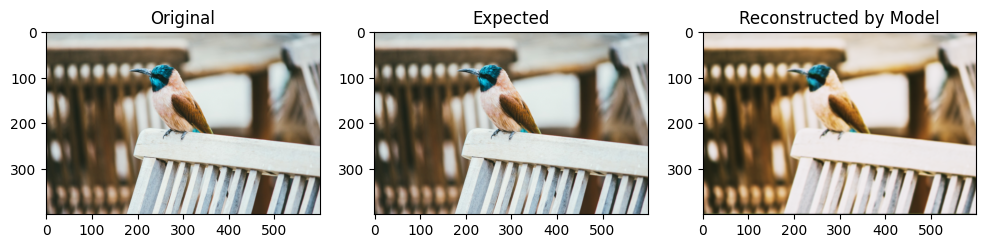

In [ ]:
plot_predictions(conv_model, train_img_gen)

#### Predictions for Test set

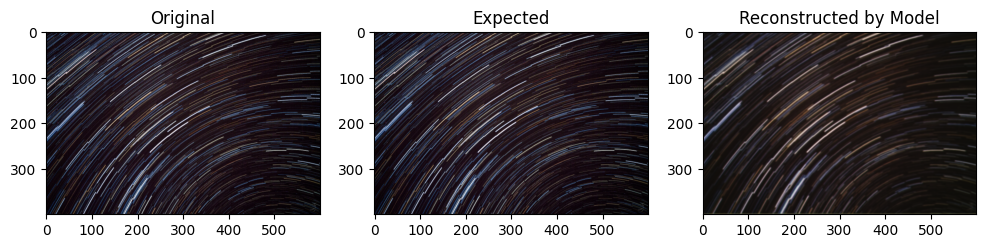

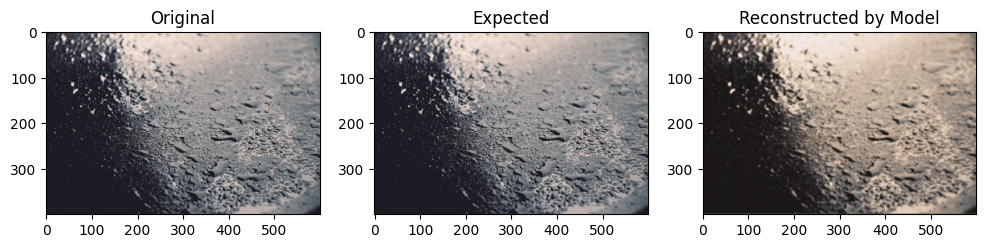

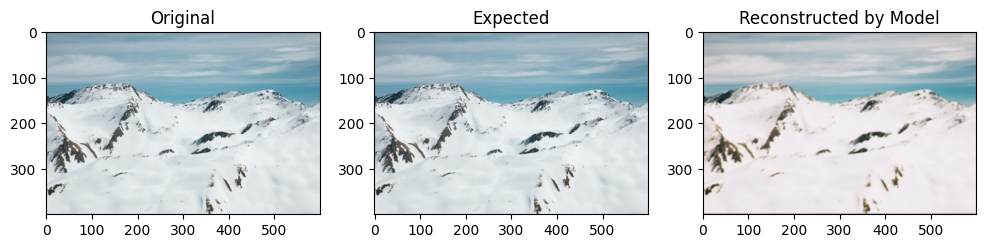

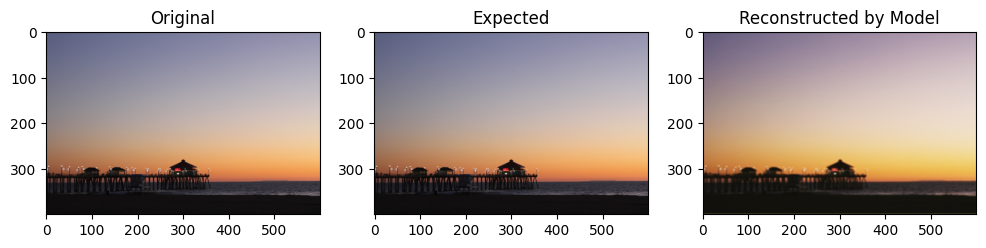

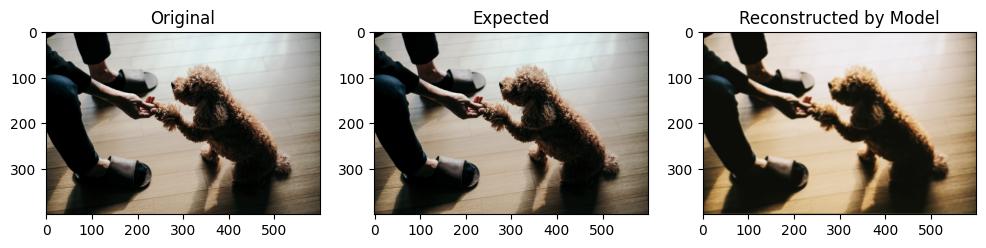

In [ ]:
plot_predictions(conv_model, test_img_gen)

### Autoencoder

In [ ]:
history = autoencoder.fit(
    train_img_gen,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    steps_per_epoch=train_samples//BATCH_SIZE,
    validation_data = val_img_gen,
    validation_steps=val_samples//BATCH_SIZE,
    callbacks=[early_stopping, reduce_lr_plateau]
)

Epoch 1/2
127/127 [==============================] - 556s 4s/step - loss: 0.0146 - accuracy: 0.6557 - mae: 0.0813 - rmse: 0.1208 - val_loss: 0.0061 - val_accuracy: 0.7167 - val_mae: 0.0537 - val_rmse: 0.0779 - lr: 0.0010
Epoch 2/2
127/127 [==============================] - 497s 4s/step - loss: 0.0044 - accuracy: 0.7998 - mae: 0.0437 - rmse: 0.0663 - val_loss: 0.0077 - val_accuracy: 0.8142 - val_mae: 0.0666 - val_rmse: 0.0875 - lr: 0.0010


#### History Plot

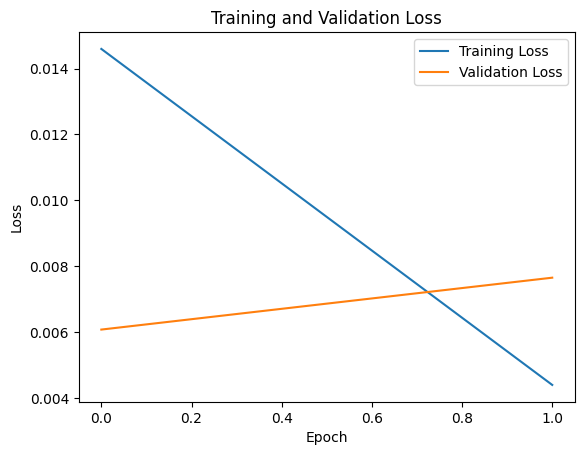

In [ ]:
plot_history(history)

#### Predictions for Training set

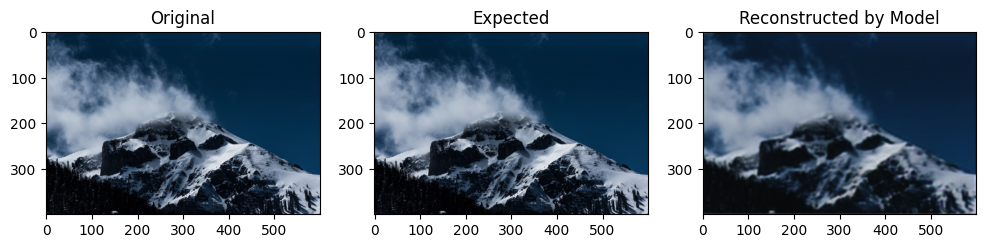

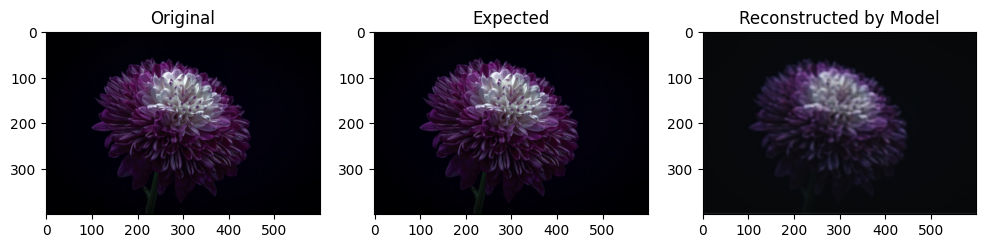

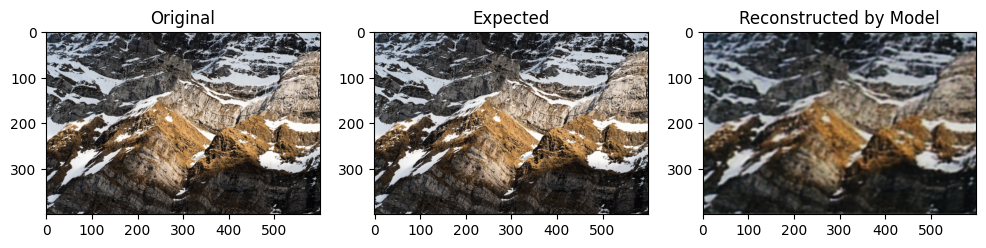

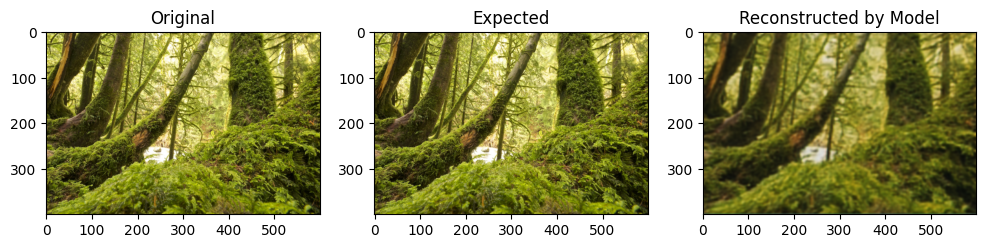

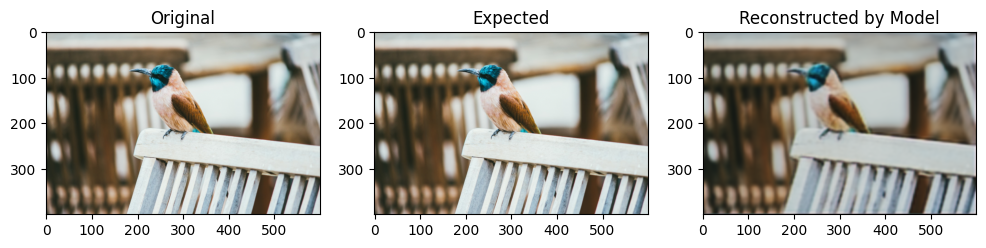

In [ ]:
plot_predictions(autoencoder, train_img_gen)

#### Predictions for Test set

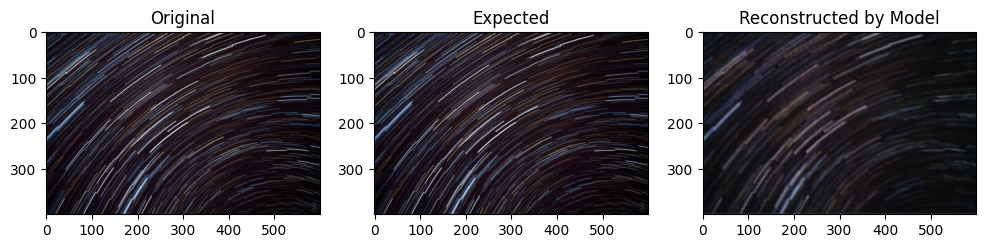

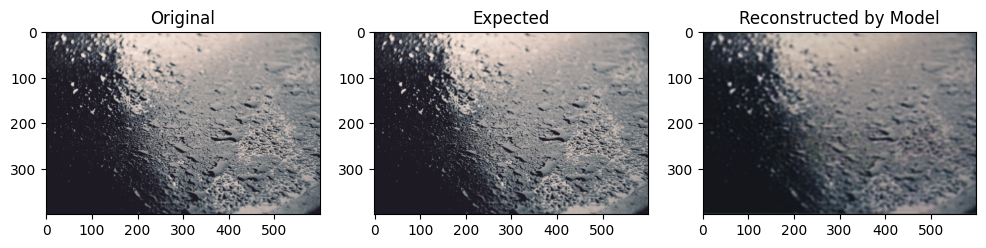

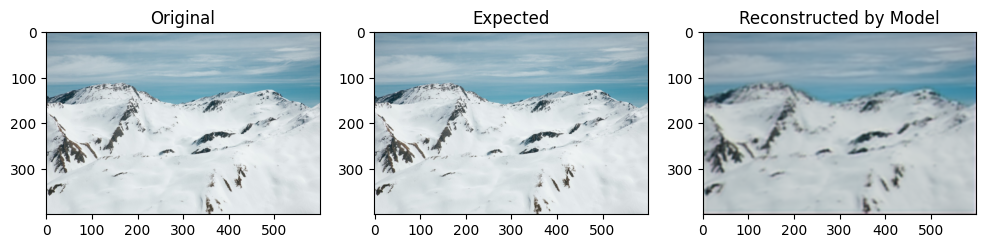

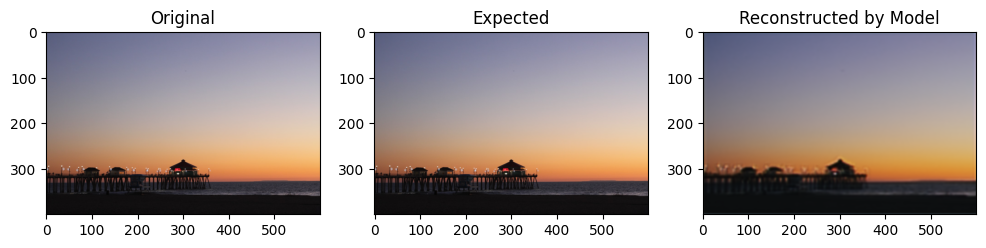

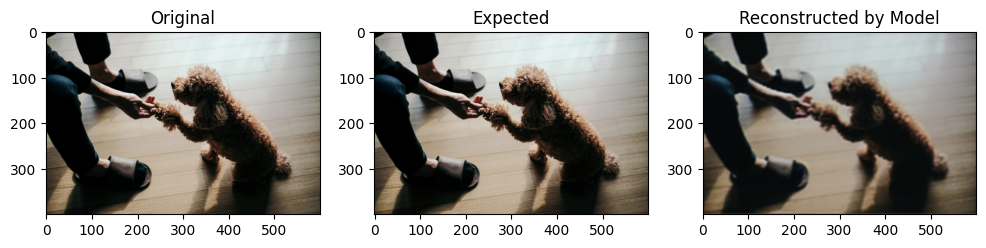

In [ ]:
plot_predictions(autoencoder, test_img_gen)

### U-net like network

In [ ]:
history = Unet.fit(
    train_img_gen,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    steps_per_epoch=train_samples//BATCH_SIZE,
    validation_data = val_img_gen,
    validation_steps=val_samples//BATCH_SIZE,
    callbacks=[early_stopping, reduce_lr_plateau]
)

Epoch 1/2
127/127 [==============================] - 410s 3s/step - loss: 0.0193 - accuracy: 0.5538 - mae: 0.0899 - rmse: 0.1391 - val_loss: 0.0044 - val_accuracy: 0.7308 - val_mae: 0.0410 - val_rmse: 0.0663 - lr: 0.0010
Epoch 2/2
 68/127 [===============>..............] - ETA: 2:42 - loss: 0.0040 - accuracy: 0.6916 - mae: 0.0402 - rmse: 0.0629

#### History Plot

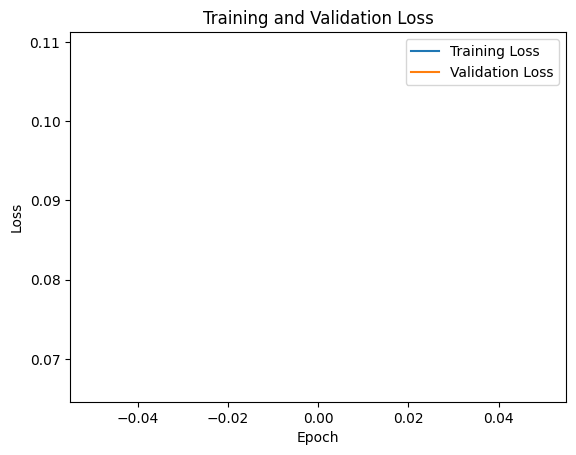

In [ ]:
plot_history(history)

#### Predictions for Training set

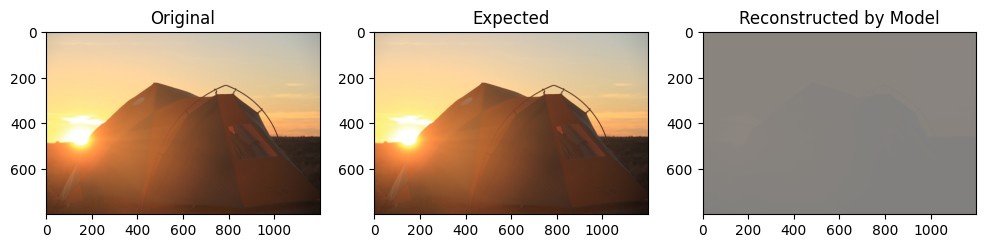

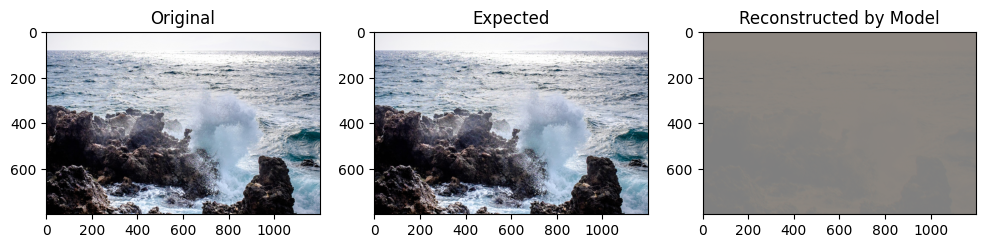

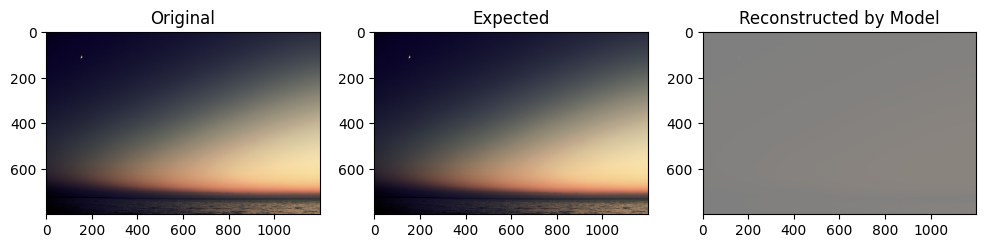

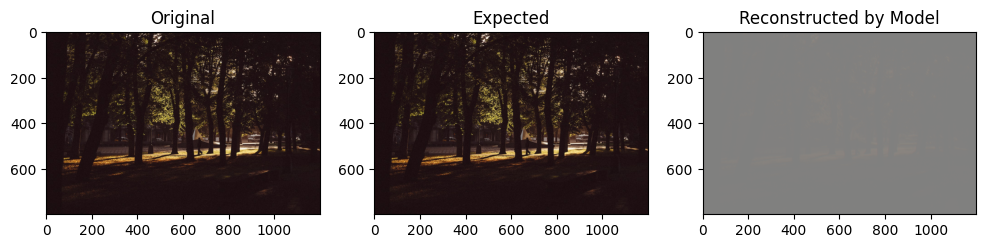

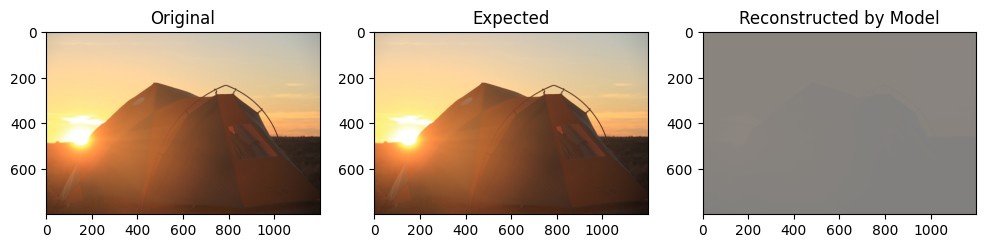

In [ ]:
plot_predictions(Unet,train_img_gen)

#### Predictions for Test set

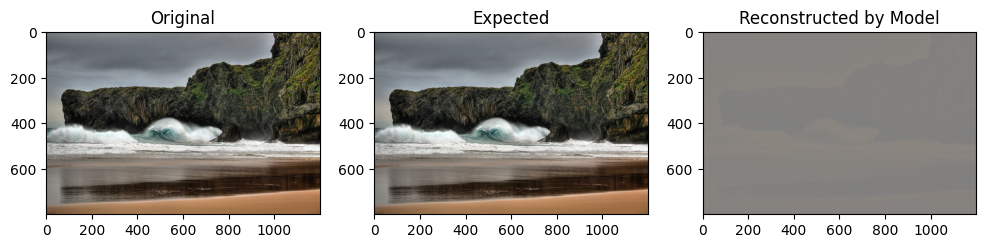

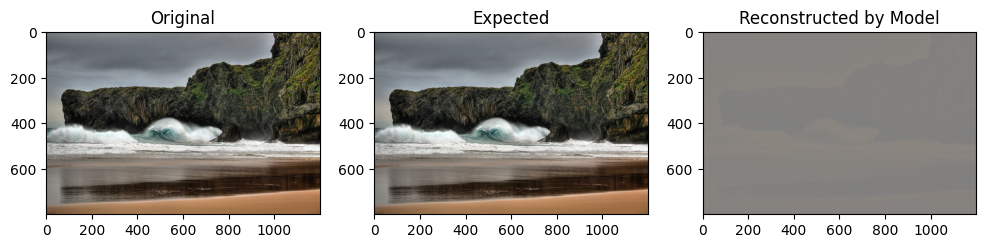

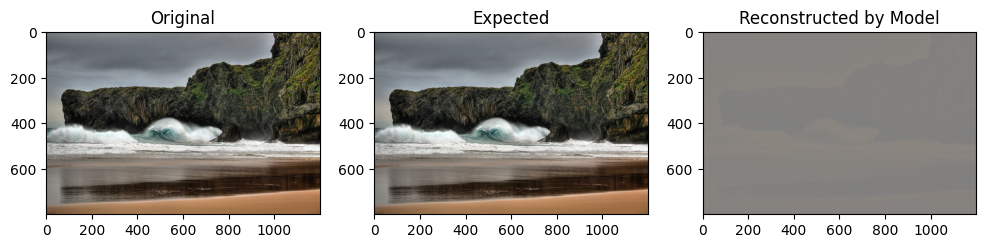

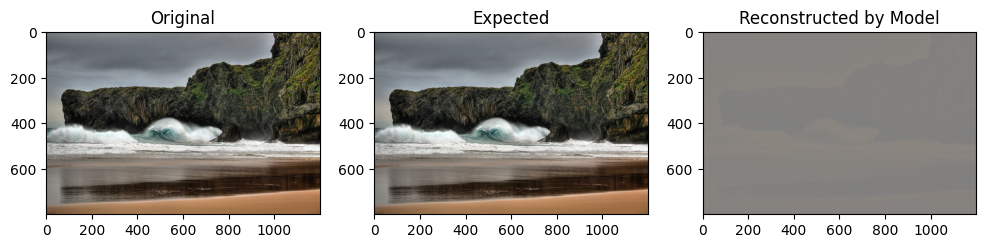

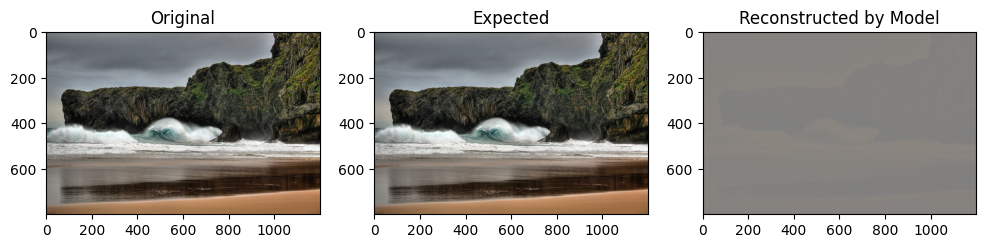

In [ ]:
plot_predictions(Unet, test_img_gen)

### Inception like model 1

In [ ]:
history = inception.fit(
    train_img_gen,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    steps_per_epoch=train_samples//BATCH_SIZE,
    validation_data = val_img_gen,
    validation_steps=val_samples//BATCH_SIZE,
    callbacks=[early_stopping, reduce_lr_plateau]
)

2/2 [==============================] - 42s 20s/step - loss: 0.2091 - output_2_loss: 0.1018 - output_1_loss: 0.1072 - output_2_accuracy: 0.5391 - output_2_mae: 0.2870 - output_2_rmse: 0.3191 - output_1_accuracy: 0.1218 - output_1_mae: 0.3023 - output_1_rmse: 0.3274 - val_loss: 0.1440 - val_output_2_loss: 0.0739 - val_output_1_loss: 0.0700 - val_output_2_accuracy: 0.4552 - val_output_2_mae: 0.2308 - val_output_2_rmse: 0.2719 - val_output_1_accuracy: 0.0084 - val_output_1_mae: 0.2316 - val_output_1_rmse: 0.2646 - lr: 0.0010


#### History Plot

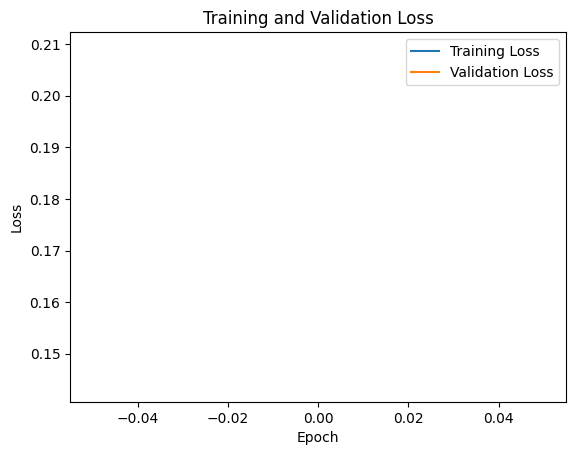

In [ ]:
plot_history(history)

#### Predictions for Training set

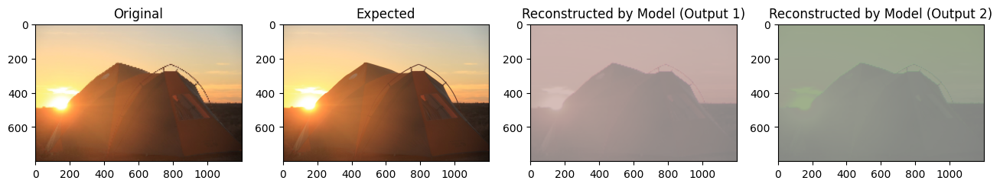

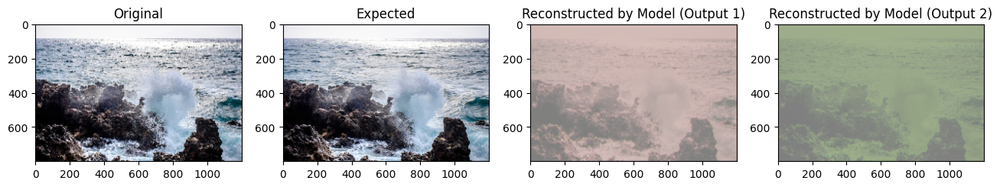

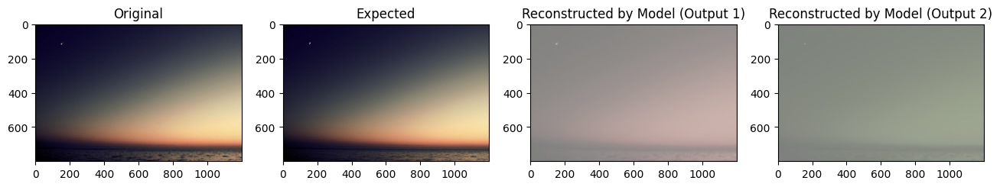

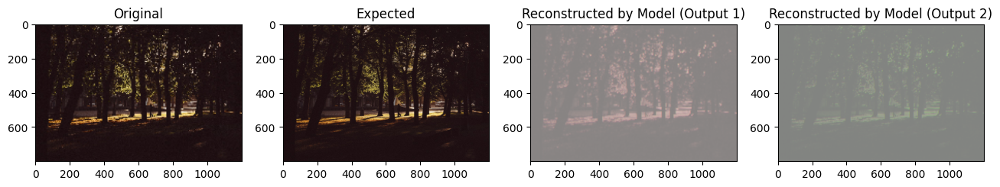

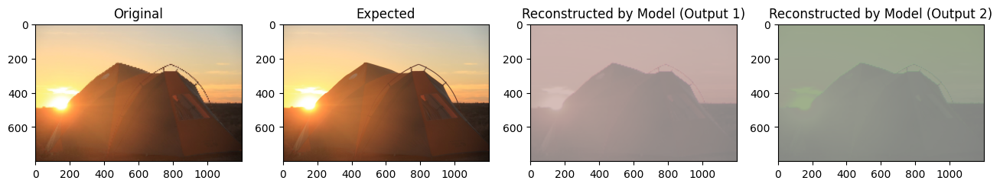

In [ ]:
plot_predictions_many_outputs(inception, train_img_gen)

#### Predictions for Test set

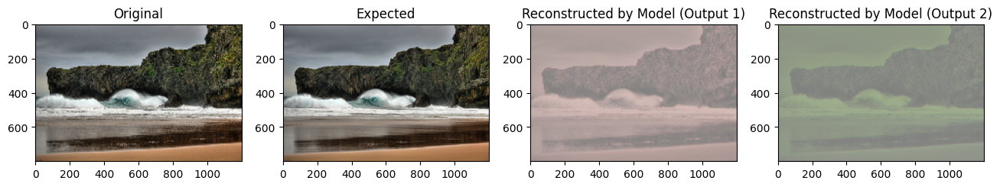

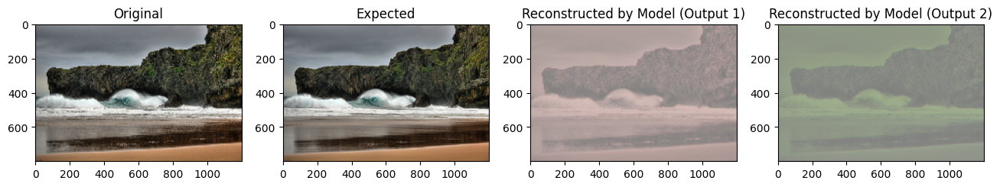

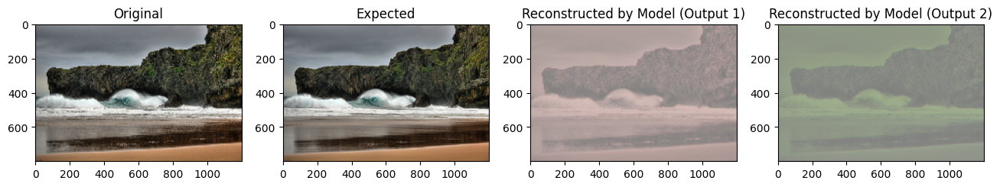

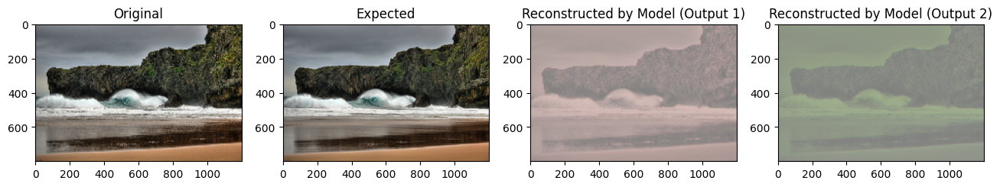

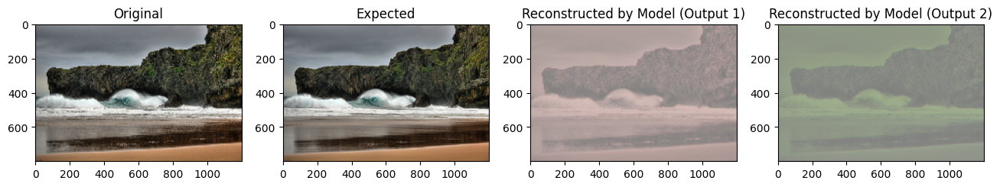

In [ ]:
plot_predictions_many_outputs(inception, test_img_gen)

### Inception like model 2

In [ ]:
history = inception_alt.fit(
    train_img_gen,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    steps_per_epoch=train_samples//BATCH_SIZE,
    validation_data = val_img_gen,
    validation_steps=val_samples//BATCH_SIZE,
    callbacks=[early_stopping, reduce_lr_plateau]
)

2/2 [==============================] - 29s 13s/step - loss: 0.3295 - output_3_loss: 0.1168 - output_1_loss: 0.1141 - output_2_loss: 0.0986 - output_3_accuracy: 0.3600 - output_3_mae: 0.2869 - output_3_rmse: 0.3417 - output_1_accuracy: 0.4910 - output_1_mae: 0.2895 - output_1_rmse: 0.3378 - output_2_accuracy: 0.4764 - output_2_mae: 0.2671 - output_2_rmse: 0.3140 - val_loss: 0.2071 - val_output_3_loss: 0.0697 - val_output_1_loss: 0.0692 - val_output_2_loss: 0.0682 - val_output_3_accuracy: 0.4063 - val_output_3_mae: 0.2343 - val_output_3_rmse: 0.2640 - val_output_1_accuracy: 0.4924 - val_output_1_mae: 0.2334 - val_output_1_rmse: 0.2631 - val_output_2_accuracy: 0.4531 - val_output_2_mae: 0.2318 - val_output_2_rmse: 0.2611 - lr: 0.0010


#### History Plot

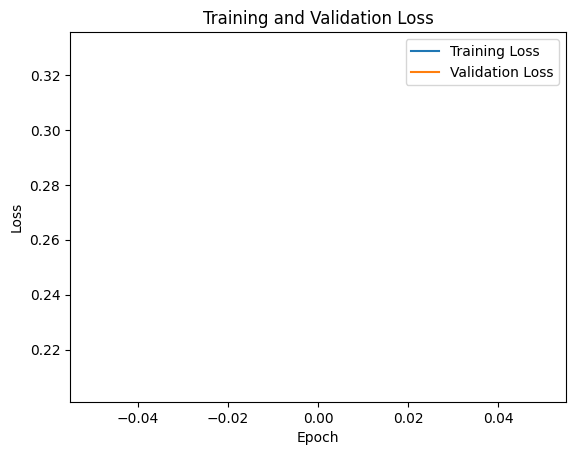

In [ ]:
plot_history(history)

#### Predictions for Training set

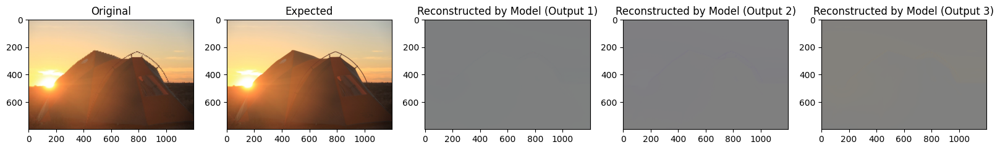

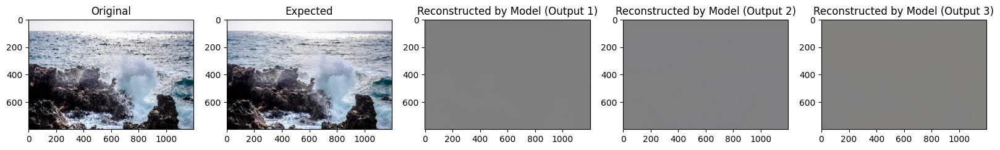

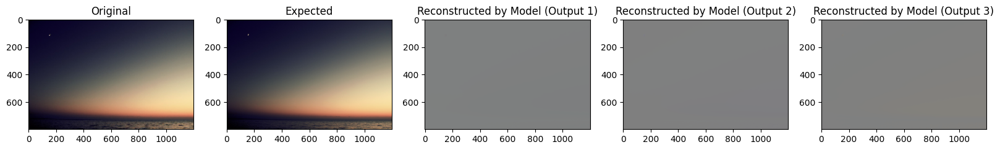

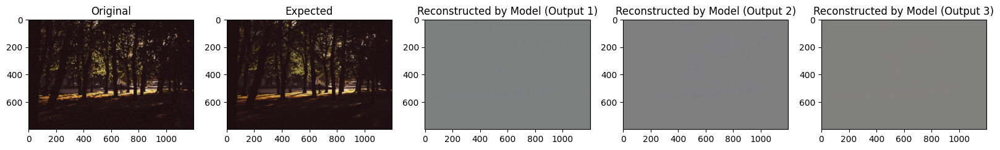

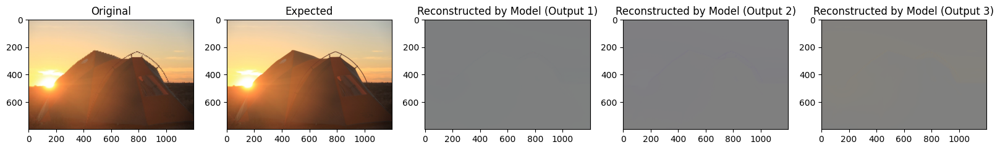

In [ ]:
plot_predictions_many_outputs(inception_alt, train_img_gen, size=(20,4))

#### Predictions for Test set

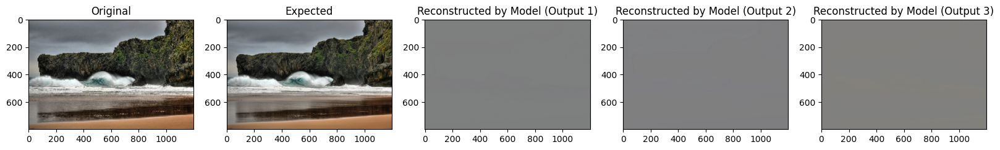

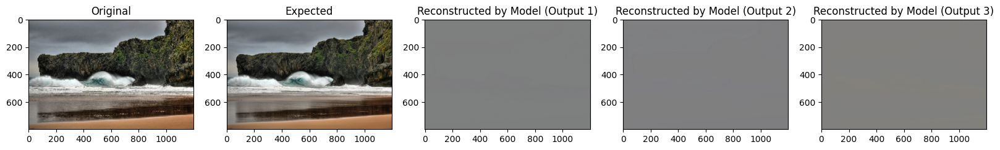

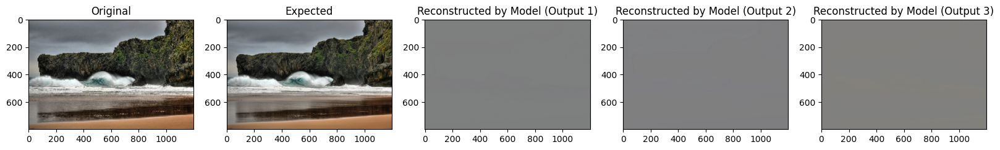

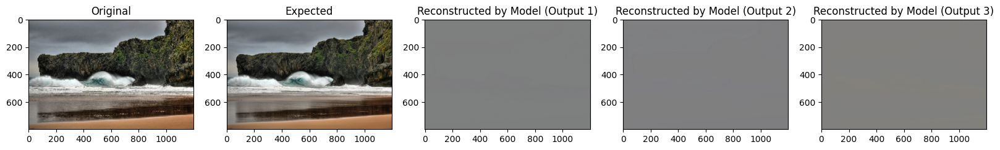

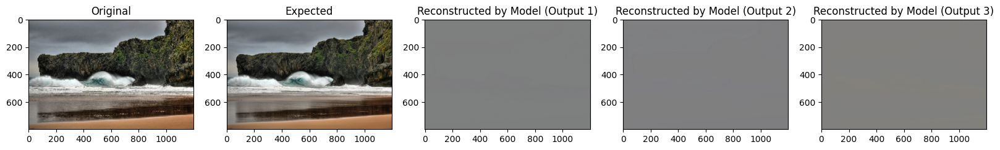

In [ ]:
plot_predictions_many_outputs(inception_alt, test_img_gen, size=(20,4))

### Skip-Connection model 1

In [ ]:
history = skip_model.fit(
    train_img_gen,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    steps_per_epoch=train_samples//BATCH_SIZE,
    validation_data = val_img_gen,
    validation_steps=val_samples//BATCH_SIZE,
    callbacks=[early_stopping, reduce_lr_plateau]
)

2/2 [==============================] - 32s 16s/step - loss: 0.1004 - accuracy: 0.1980 - mae: 0.2882 - rmse: 0.3169 - val_loss: 0.0791 - val_accuracy: 0.1150 - val_mae: 0.2409 - val_rmse: 0.2812 - lr: 0.0010


#### History Plot

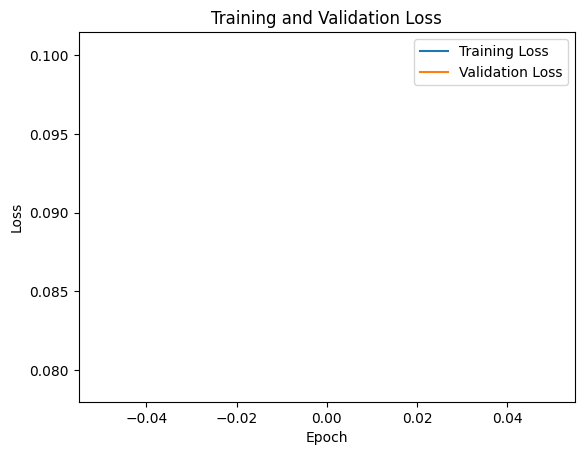

In [ ]:
plot_history(history)

#### Predictions for Training set

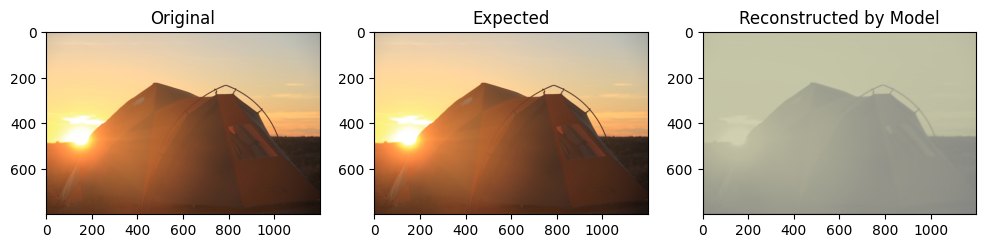

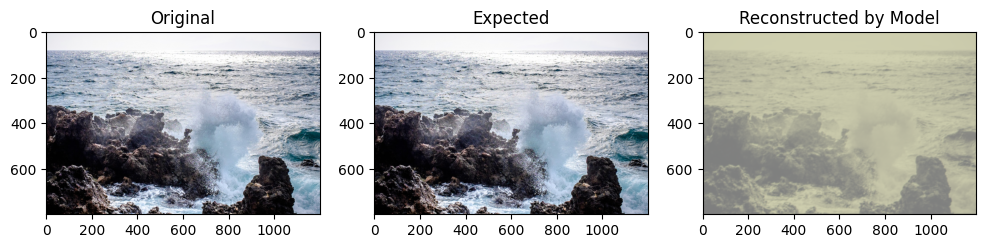

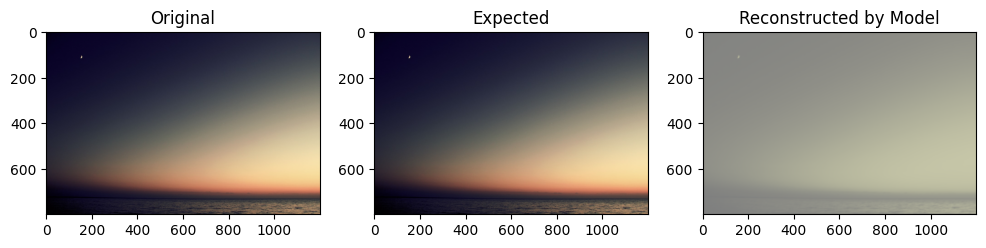

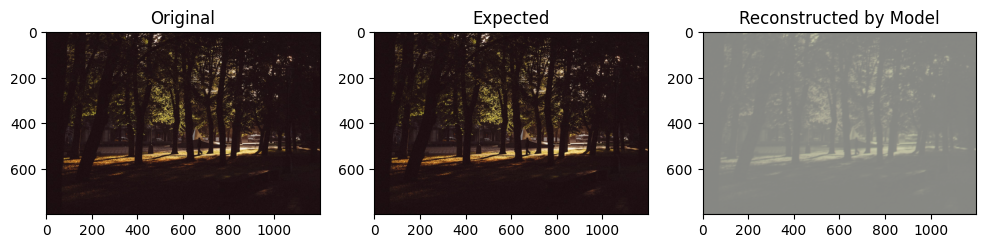

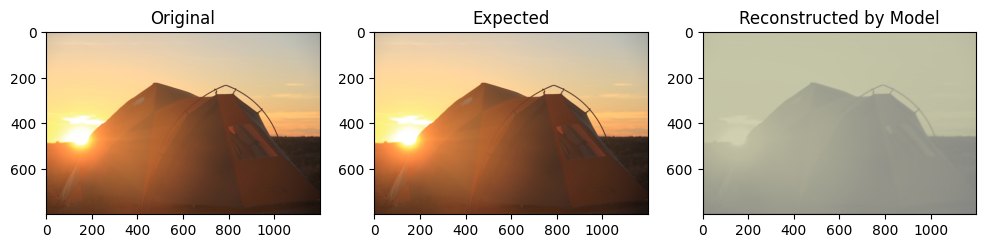

In [ ]:
plot_predictions(skip_model, train_img_gen)

#### Predictions for Test set

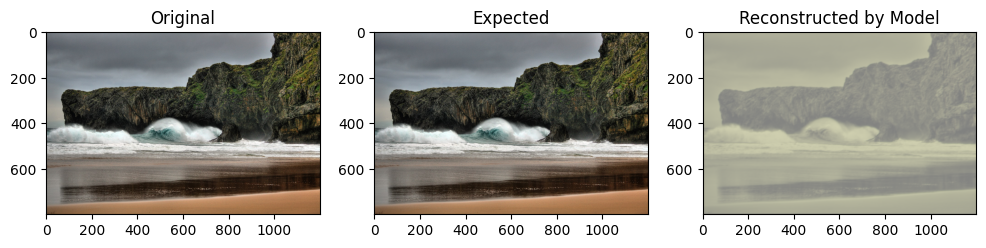

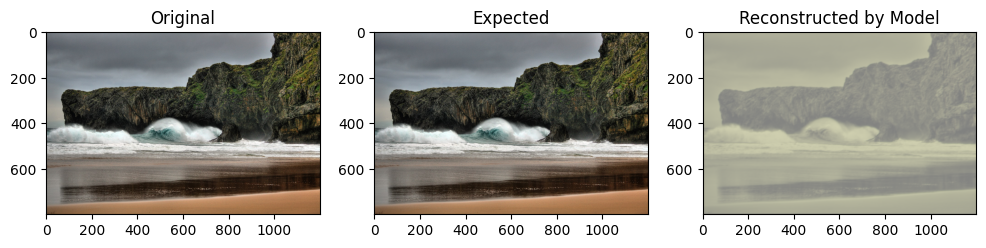

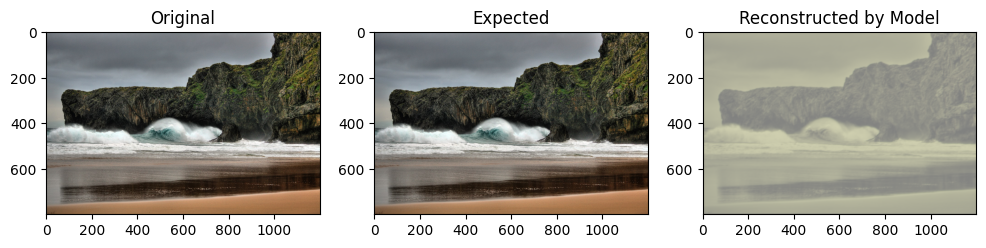

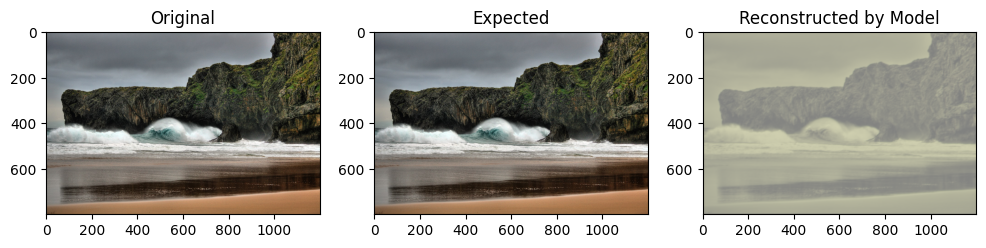

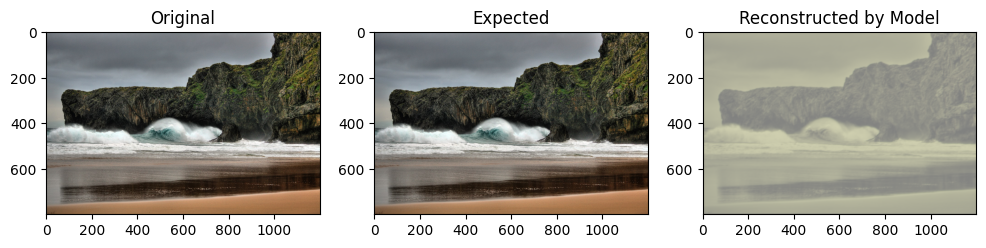

In [ ]:
plot_predictions(skip_model, test_img_gen)

### Skip-Connection model 2

In [ ]:
history = skip_model_2.fit(
    train_img_gen,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    steps_per_epoch=train_samples//BATCH_SIZE,
    validation_data = val_img_gen,
    validation_steps=val_samples//BATCH_SIZE,
    callbacks=[early_stopping, reduce_lr_plateau]
)

2/2 [==============================] - 43s 21s/step - loss: 0.1088 - accuracy: 0.3031 - mae: 0.2936 - rmse: 0.3298 - val_loss: 0.0690 - val_accuracy: 0.5428 - val_mae: 0.2328 - val_rmse: 0.2628 - lr: 0.0010


#### History Plot

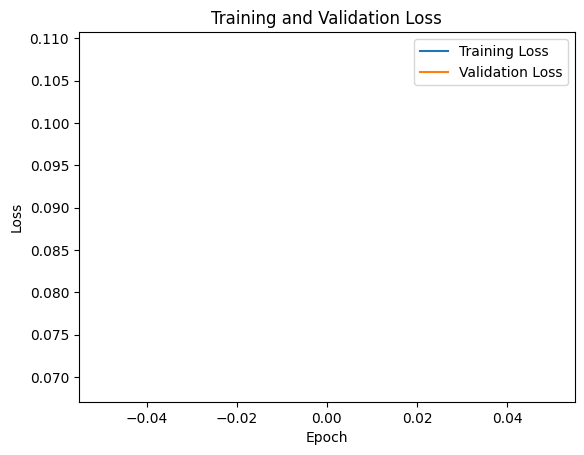

In [ ]:
plot_history(history)

#### Predictions for Training set

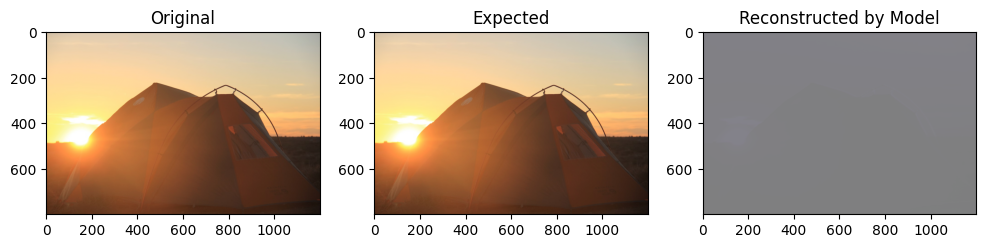

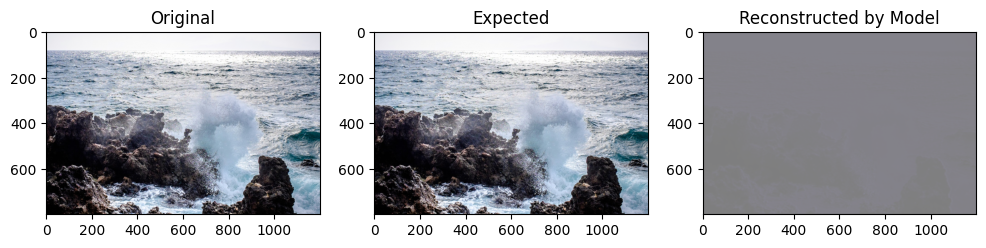

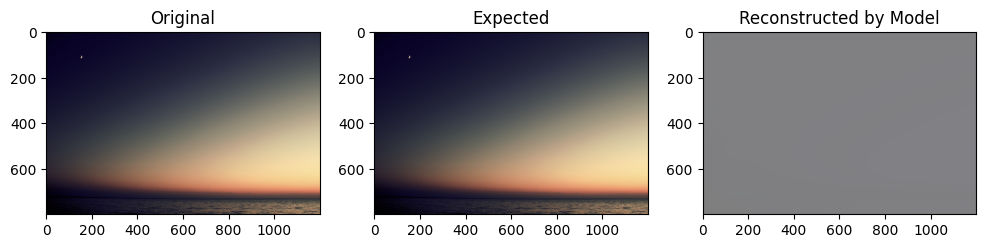

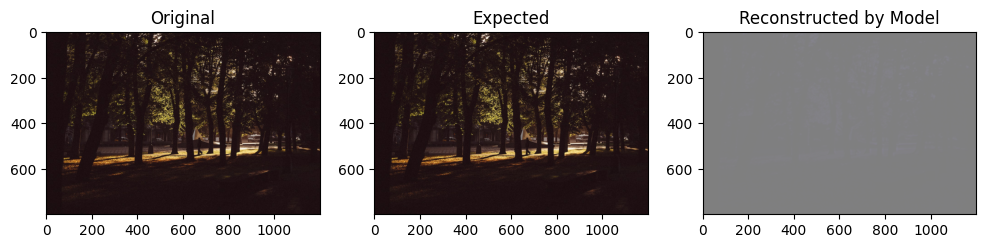

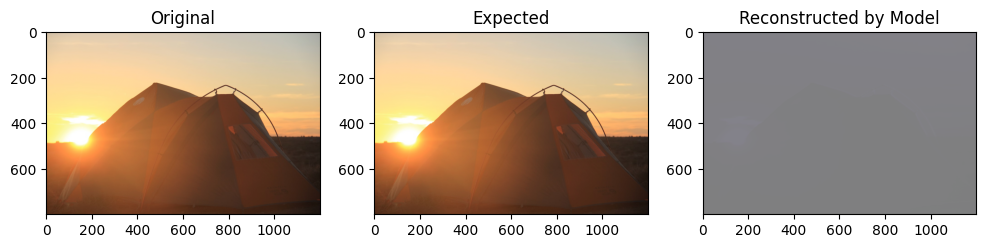

In [ ]:
plot_predictions(skip_model_2, train_img_gen)

#### Predictions for Test set

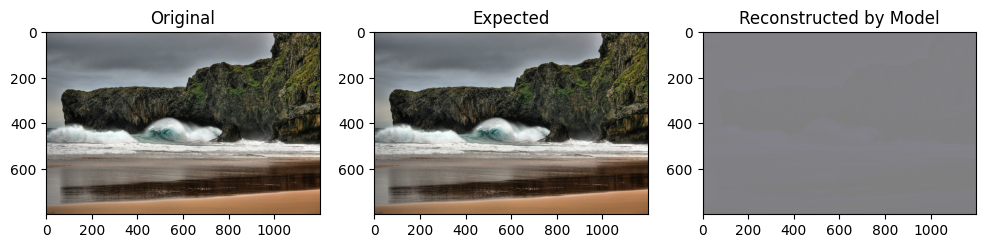

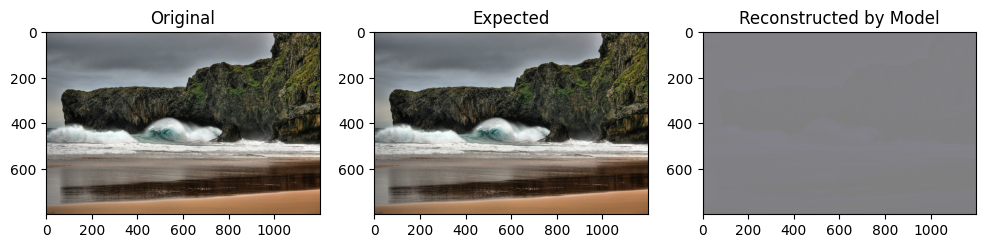

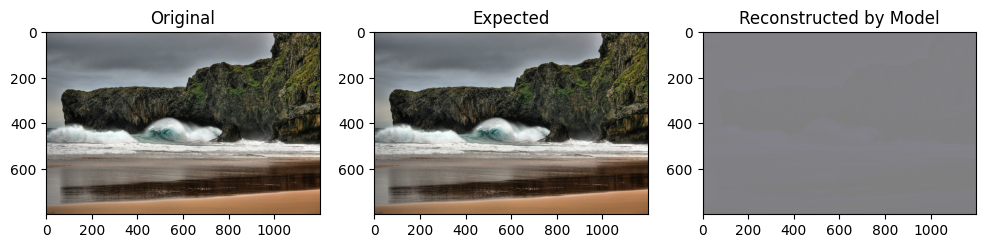

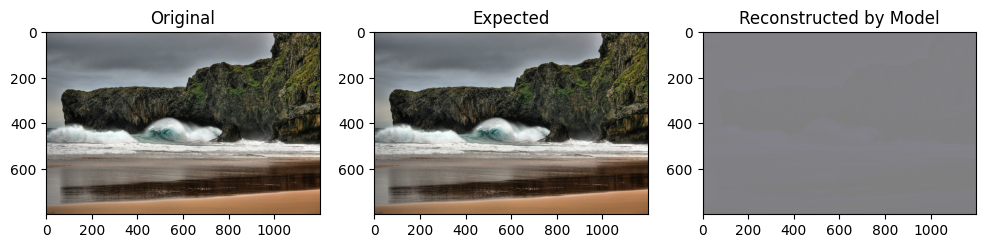

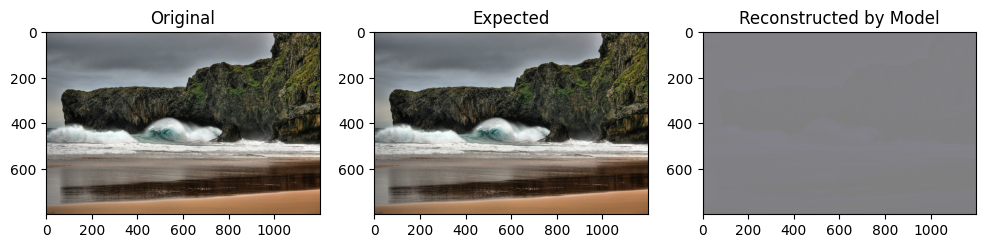

In [ ]:
plot_predictions(skip_model_2, test_img_gen)

### GANs

#### Training

In [ ]:
tf.config.run_functions_eagerly(True)

In [ ]:
best_val_loss = float('inf')
early_stopping_patience = 10
early_stopping_counter = 0

train_gen_losses = []
train_disc_losses = []
avr_train_gen_losses = []
avr_train_disc_losses = []
val_gen_losses = []
val_disc_losses = []

mae_list = []
mse_list = []
accuracy_list = []

@tf.function
def train_step(X, y):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        real_output = discriminator(y, training=True)
        generated_images = generator(X, training=True)
        fake_output = discriminator(generated_images, training=True)
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    train_gen_losses.append(gen_loss)
    train_disc_losses.append(disc_loss)

    try:
        mae_list.append(tf.abs(generated_images - y))
        mse_list.append(tf.square(generated_images - y))
        accuracy_list.append(tf.keras.metrics.binary_accuracy(generated_images, y))
    except:
        pass

for epoch in tqdm(range(EPOCHS), desc="Training Epochs", unit="epoch"):
    for batch_X, batch_y in train_img_gen:
        train_step(batch_X, batch_y)

    val_losses = []
    val_mae = []
    val_mse = []
    val_accuracy = []

    for val_batch_X, val_batch_y in val_img_gen:
        val_real_output = discriminator(val_batch_y, training=False)
        val_generated_images = generator(val_batch_X, training=False)
        val_fake_output = discriminator(val_generated_images, training=False)
        val_gen_loss = generator_loss(val_fake_output)
        val_disc_loss = discriminator_loss(val_real_output, val_fake_output)
        val_losses.append((val_gen_loss, val_disc_loss))

    val_mae.append(np.abs(val_real_output.numpy() - val_fake_output.numpy()))
    val_mse.append(np.square(val_real_output.numpy() - val_fake_output.numpy()))
    val_accuracy.append(tf.keras.metrics.binary_accuracy(val_real_output.numpy(), val_fake_output.numpy()))

    avg_val_gen_loss = tf.reduce_mean([loss[0] for loss in val_losses])
    avg_val_disc_loss = tf.reduce_mean([loss[1] for loss in val_losses])
    avr_train_gen_losses.append(tf.reduce_mean(train_gen_losses))
    avr_train_disc_losses.append(tf.reduce_mean(train_disc_losses))

    mae = tf.reduce_mean(mae_list)
    mse = tf.reduce_mean(mse_list)
    accuracy = tf.reduce_mean(accuracy_list)
    val_gen_losses.append(avg_val_gen_loss)
    val_disc_losses.append(avg_val_disc_loss)

    val_mae = np.array(val_mae)

    print(f"Epoch {epoch + 1}, "
          f"Average Training Generator Loss: {avr_train_gen_losses[-1]}, "
          f"Average Training Discriminator Loss: {avr_train_disc_losses[-1]}, "
          f"Average Validation Generator Loss: {avg_val_gen_loss}, "
          f"Average Validation Discriminator Loss: {avg_val_disc_loss}, "
          f"Average Training MAE: {mae}, "
          f"Average Training MSE: {mse}, "
          f"Average Training Accuracy: {accuracy}"
          f"Average Validation MAE: {tf.reduce_mean(val_mae)}, "
          f"Average Validation MSE: {tf.reduce_mean(val_mse)}, "
          f"Average Validation Accuracy: {tf.reduce_mean(val_accuracy)}",
          )
    
    mae_list = []
    mse_list = []
    accuracy_list = []

    if avg_val_gen_loss < best_val_loss:
        best_val_loss = avg_val_gen_loss
        early_stopping_counter = 0
    else:
        early_stopping_counter += 1

    if early_stopping_counter == early_stopping_patience:
        print(f"Early stopping at epoch {epoch + 1} due to no improvement in validation loss.")
        generator.load_weights('best_generator_weights.h5')
        discriminator.load_weights('best_discriminator_weights.h5')
        break

    train_img_gen.reset()
    val_img_gen.reset()

print("Finished!")

Training Epochs:   0%|          | 0/2 [00:00<?, ?epoch/s]d:\CV - SuperResolution\super-resolution\lib\site-packages\keras\src\backend.py:5818: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Sigmoid activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(


Epoch 1, Average Training Generator Loss: 0.6407185196876526, Average Training Discriminator Loss: 1.363006591796875, Average Validation Generator Loss: 0.5102807283401489, Average Validation Discriminator Loss: 1.4796584844589233, Average Training MAE: nan, Average Training MSE: nan, Average Training Accuracy: nanAverage Validation MAE: 0.030572593212127686, Average Validation MSE: 0.0009346834267489612, Average Validation Accuracy: 0.0


Training Epochs: 100%|██████████| 2/2 [02:17<00:00, 68.90s/epoch]

Epoch 2, Average Training Generator Loss: 0.580205500125885, Average Training Discriminator Loss: 1.3352251052856445, Average Validation Generator Loss: 0.6148386001586914, Average Validation Discriminator Loss: 1.4055054187774658, Average Training MAE: nan, Average Training MSE: nan, Average Training Accuracy: nanAverage Validation MAE: 0.006745815277099609, Average Validation MSE: 4.550602534436621e-05, Average Validation Accuracy: 0.0
Finished!


#### History Plot

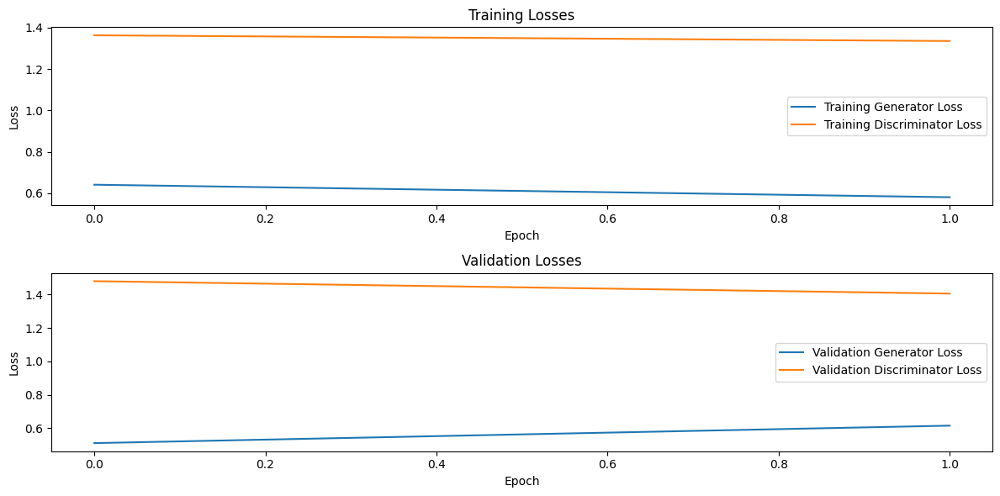

In [ ]:
plt.figure(figsize=(12, 6))

plt.subplot(2, 1, 1)
plt.plot(avr_train_gen_losses, label='Training Generator Loss')
plt.plot(avr_train_disc_losses, label='Training Discriminator Loss')
plt.title('Training Losses')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(val_gen_losses, label='Validation Generator Loss')
plt.plot(val_disc_losses, label='Validation Discriminator Loss')
plt.title('Validation Losses')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

#### Predictions for Training set

d:\CV - SuperResolution\super-resolution\lib\site-packages\tensorflow\python\data\ops\structured_function.py:258: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


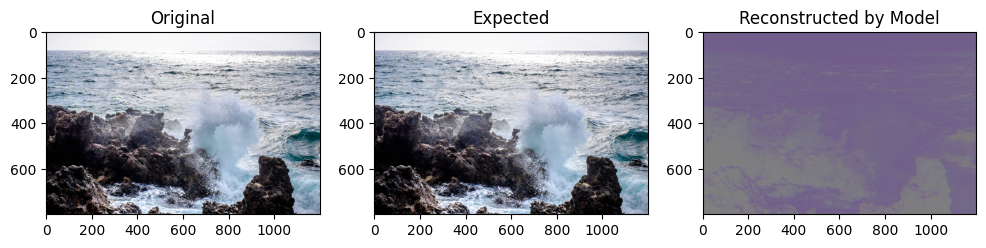

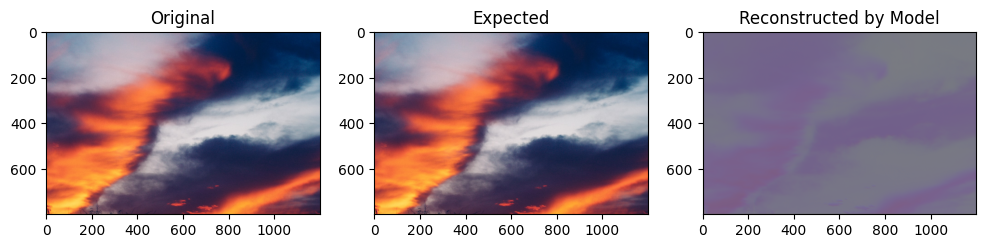

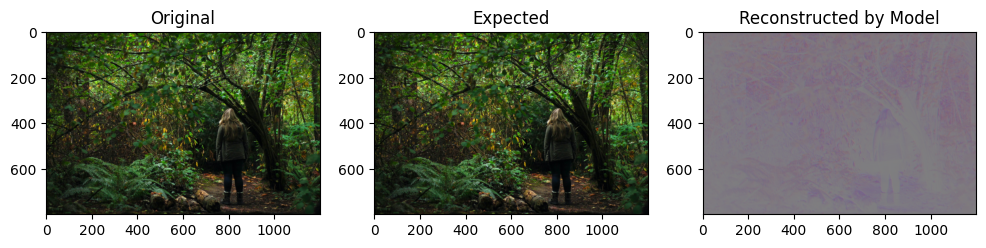

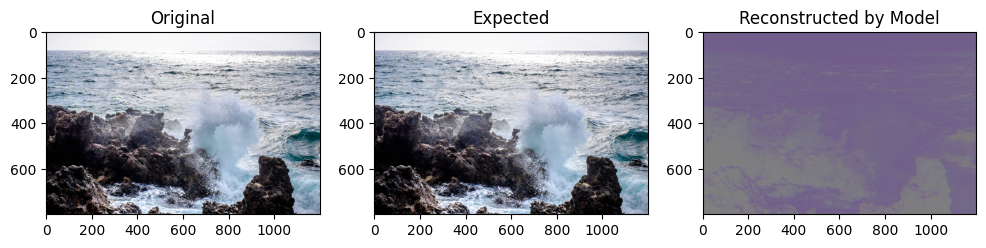

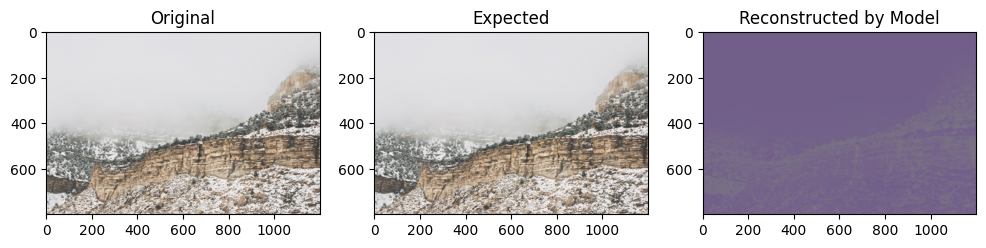

In [ ]:
plot_predictions(generator, train_img_gen)

#### Predictions for Test set

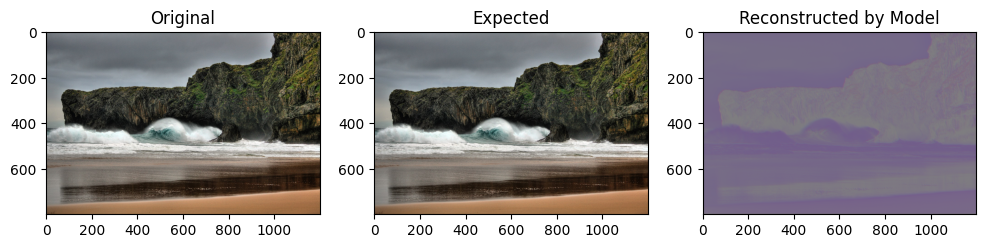

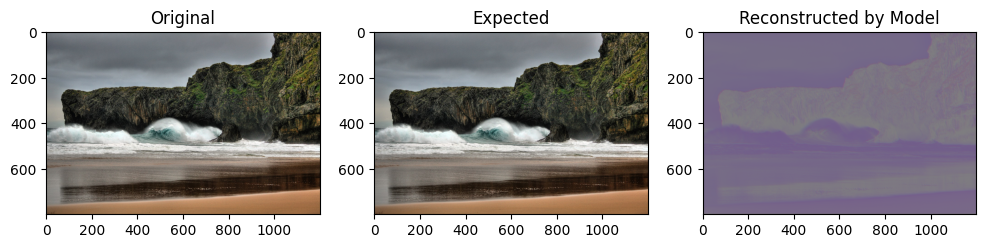

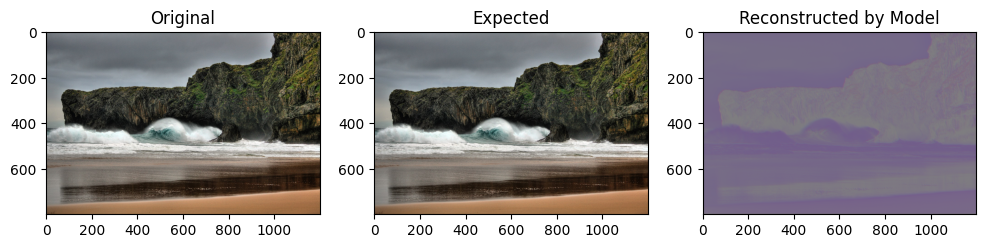

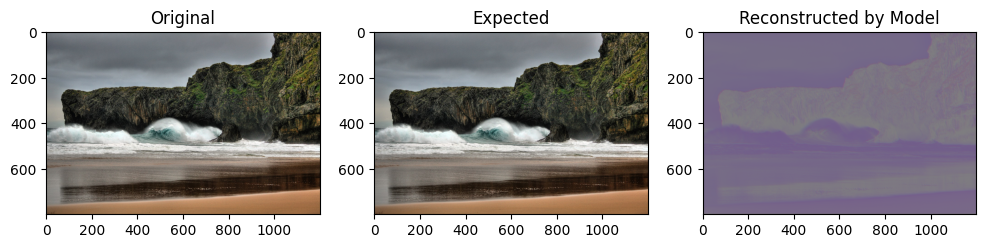

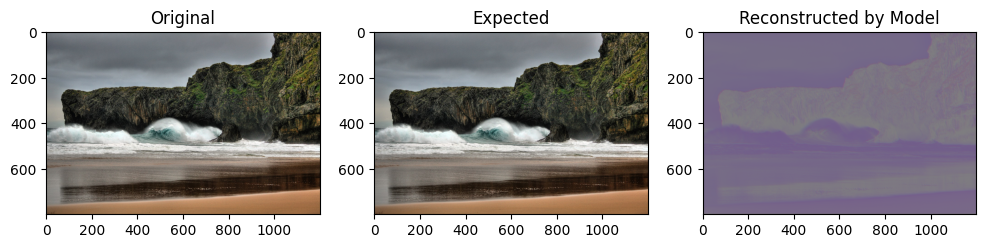

In [ ]:
plot_predictions(generator, val_img_gen)